In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import scirpy as ir
from matplotlib import pyplot as plt, cm as mpl_cm
from cycler import cycler

sc.set_figure_params(figsize=(4, 4))
sc.settings.verbosity = 2  # verbosity: errors (0), warnings (1), info (2), hints (3)

In [3]:
sc.logging.print_header()

scanpy==1.9.3 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.10.1 pandas==1.5.3 scikit-learn==1.0 statsmodels==0.13.5 python-igraph==0.10.4 louvain==0.8.0 pynndescent==0.5.8


In [4]:
import os
os.chdir("/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_h5")

In [5]:
adata1=sc.read_h5ad('/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/Data/Scanpy_merge_rmdoubulet_UMAP_label_lastCell.h5ad')

In [6]:
adata1

AnnData object with n_obs × n_vars = 245834 × 31424
    obs: 'Name', 'doublet_scores', 'predicted_doublets', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Cellname', 'AdjustedID', 'New_Body', 'Week', 'TCRBCRlabel', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Last_cell_type', 'Cell_lineage', 'Last_cell_type2', 'Last_cell_type_num', 'Last_cell_type_num2'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'AdjustedID_colors', 'Cell_lineage_colors', 'Last_cell_type_num_colors', 'New_Body_colors', 'TCRBCRlabel_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'majority_voting_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

In [7]:
import rpy2.robjects as robjects
from rpy2.robjects.packages import importr

import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

anndata2ri.activate()
%load_ext rpy2.ipython


In [8]:
%%R -w 500 -h 300 
TCRdir="/data1/maolp/Rstudy/GaofengSinglecell/Gaofeng_All_matrix/Allcount/TCR_all/"
TCRsamples=list.files(path = TCRdir,"csv")
AllTCR=data.frame()
for (line in TCRsamples) {
#   print(line)
  name=gsub("_TCR_filtered_contig_annotations.csv","",line)
  print(name)
  if (!name %in% c("C27","Z28")){
     Test_TCR<-read.csv(file.path(TCRdir,line))
     Test_TCR$barcodename=paste0(name,"_",Test_TCR$barcode)
     Test_TCR$Group<-name
     AllTCR=rbind(AllTCR,Test_TCR)
  }
 
}
head(AllTCR)


[1] "B25"
[1] "B9"
[1] "C10"
[1] "C25"
[1] "C27"
[1] "C36"
[1] "D25"
[1] "D27"
[1] "D36"
[1] "D9"
[1] "Z03"
[1] "Z07"
[1] "z104"
[1] "Z123"
[1] "Z28"
[1] "Z33"
[1] "Z36"
[1] "Z38"
[1] "Z42"
[1] "Z43"
[1] "Z47"
[1] "Z48"
[1] "Z50"
[1] "Z52"
[1] "Z53"
[1] "Z67"
[1] "Z70"
[1] "Z77"
[1] "Z79"
[1] "Z96"
[1] "Z98"
[1] "Z99"
             barcode is_cell                   contig_id high_confidence length
1 AAACCTGAGCACCGCT-1    true AAACCTGAGCACCGCT-1_contig_1            true    509
2 AAACCTGAGCACCGCT-1    true AAACCTGAGCACCGCT-1_contig_2            true    506
3 AAACCTGAGCGAAGGG-1    true AAACCTGAGCGAAGGG-1_contig_1            true    464
4 AAACCTGAGCGAAGGG-1    true AAACCTGAGCGAAGGG-1_contig_2            true    488
5 AAACCTGAGCGAAGGG-1    true AAACCTGAGCGAAGGG-1_contig_3            true    651
6 AAACCTGCAAACGCGA-1    true AAACCTGCAAACGCGA-1_contig_1            true    492
  chain       v_gene d_gene  j_gene c_gene full_length productive
1   TRB     TRBV20-1        TRBJ2-7  TRBC2        true

In [9]:
mkdir -p /data5/maolp/Gaofeng_All_matrix/Allcount/All_scanpyData/BCRTCR/

In [10]:
%%R -w 500 -h 300 
getwd()
write.csv(AllTCR,"/data5/maolp/Gaofeng_All_matrix/Allcount/All_scanpyData/BCRTCR/Gao_All_TCR.csv")

In [11]:
path_data = "/data5/maolp/Gaofeng_All_matrix/Allcount/All_scanpyData/BCRTCR"
path_bcr_input = f"{path_data}/Gao_All_BCR.csv"
path_tcr_input = f"{path_data}/Gao_All_TCR.csv"

In [12]:
path_bcr_csv = f"{path_data}/BCR_read_aligned.csv"
path_bcr_out = f"{path_data}/BCR_preprocessed.h5ad"

path_tcr_csv = f"{path_data}/TCR_read_aligned.csv"
path_tcr_out = f"{path_data}/TCR_preprocessed.h5ad"

In [13]:
df_tcr_raw = pd.read_csv(path_tcr_input, index_col=0)

df_tcr_raw["barcode"] =df_tcr_raw["barcodename"]

df_tcr_raw.to_csv(path_tcr_csv)

In [14]:
df_tcr_raw["productive"].value_counts()

True    154563
Name: productive, dtype: int64

In [15]:
adata_tcr = ir.io.read_10x_vdj(path_tcr_csv)
print(f"Amount cells: {len(adata_tcr)}")

Amount cells: 78452


In [16]:
ir.pp.merge_with_ir(adata1, adata_tcr)

In [17]:
# adata1.write_h5ad('/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/Data/Scanpy_merge_rmdoubulet_UMAP_label_lastCell.h5ad')

In [18]:
adata_tcr2=adata_tcr
import pandas as pd

# 将adata_bcr2.obs与adata3.obs合并，仅保留adata_bcr2中的匹配项
TCRmerged_obs = adata_tcr2.obs.merge(adata1.obs, left_index=True, right_index=True, how='left', suffixes=('', '_y'))


adata_tcr2.obs = TCRmerged_obs

In [19]:
ir.tl.chain_qc(adata1)

ir.tl.chain_qc(adata_tcr2)

In [20]:
adata1_IR = adata1[adata1.obs['chain_pairing'] != 'no IR']
ir.tl.chain_qc(adata1_IR)

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scirpy/tl/_chain_qc.py:162: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[col_receptor_type] = res_receptor_type


<Figure size 1280x480 with 0 Axes>

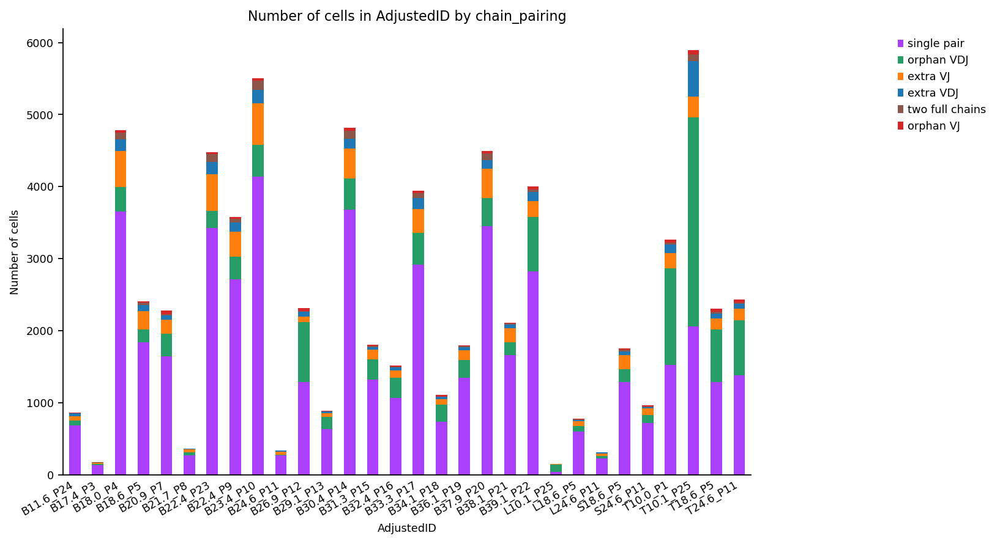

In [21]:
import matplotlib.pyplot as plt
# Figurepath_data = "/data5/maolp/Gaofeng_All_matrix/Allcount/All_dealdata/TCRBCRdata/Figure/"
plt.figure(figsize=(16, 6)) 
ax = ir.pl.group_abundance(adata_tcr2, groupby="AdjustedID", target_col="chain_pairing", sort="alphabetical",fig_kws={"figsize": (9, 6)})
fig = ax.figure
# fig.savefig(Figurepath_data+"group_abundance.png", dpi=300, bbox_inches="tight")


<Figure size 1280x480 with 0 Axes>

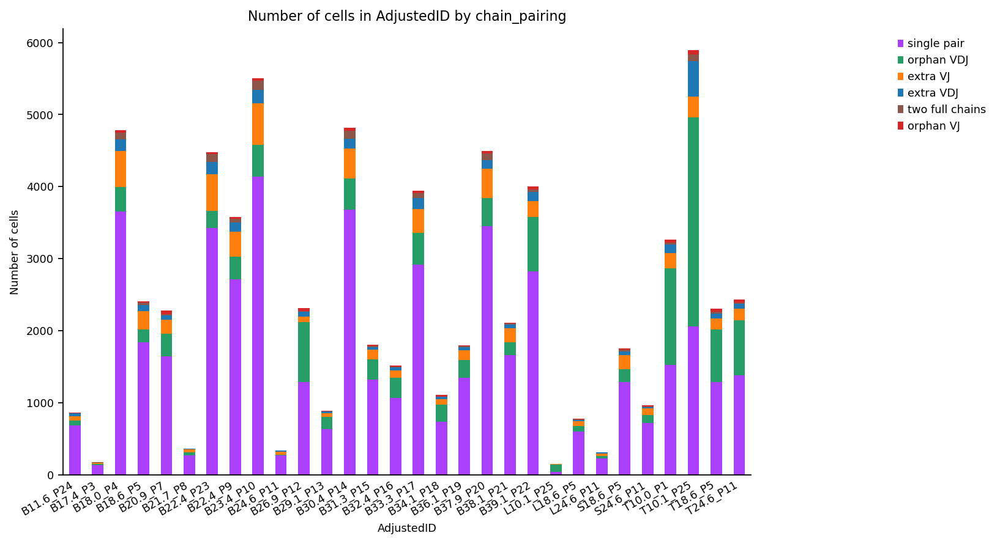

In [22]:
import matplotlib.pyplot as plt
# Figurepath_data = "/data5/maolp/Gaofeng_All_matrix/Allcount/All_dealdata/TCRBCRdata/Figure/"
plt.figure(figsize=(16, 6)) 
ax = ir.pl.group_abundance(adata1_IR, groupby="AdjustedID", target_col="chain_pairing", sort="alphabetical",fig_kws={"figsize": (9, 6)})
# fig = ax.figure
# fig.savefig(Figurepath_data+"group_abundance.png", dpi=300, bbox_inches="tight")


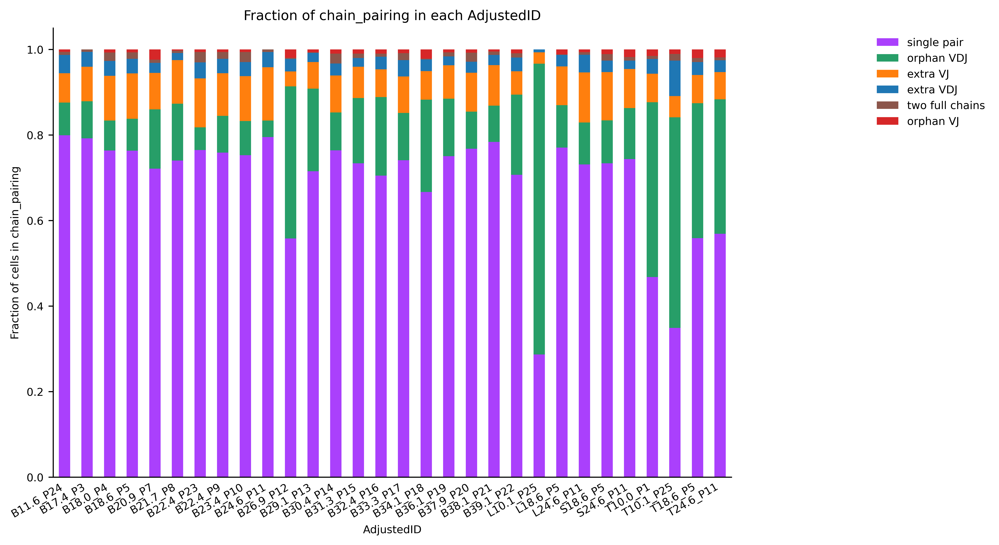

In [23]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
_ = ir.pl.group_abundance(
    adata1_IR, groupby="AdjustedID", target_col="chain_pairing", sort="alphabetical", normalize=True,fig_kws={"figsize": (9, 6)}
)

<Figure size 4800x1800 with 0 Axes>

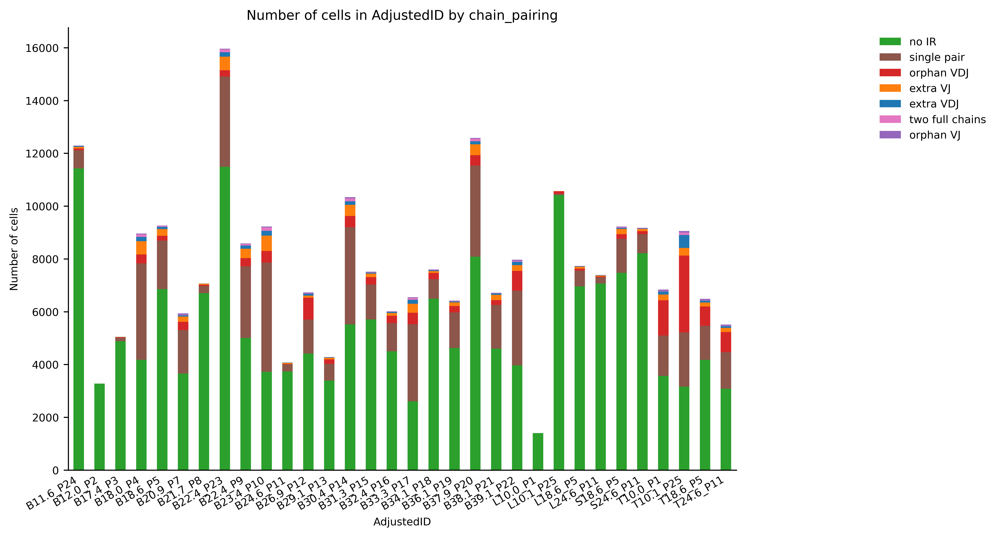

In [24]:
import matplotlib.pyplot as plt
# Figurepath_data = "/data5/maolp/Gaofeng_All_matrix/Allcount/All_dealdata/TCRBCRdata/Figure/"
plt.figure(figsize=(16, 6)) 
ax = ir.pl.group_abundance(adata1, groupby="AdjustedID", target_col="chain_pairing", sort="alphabetical",fig_kws={"figsize": (9, 6)})
# fig = ax.figure
# fig.savefig(Figurepath_data+"group_abundance.png", dpi=300, bbox_inches="tight")


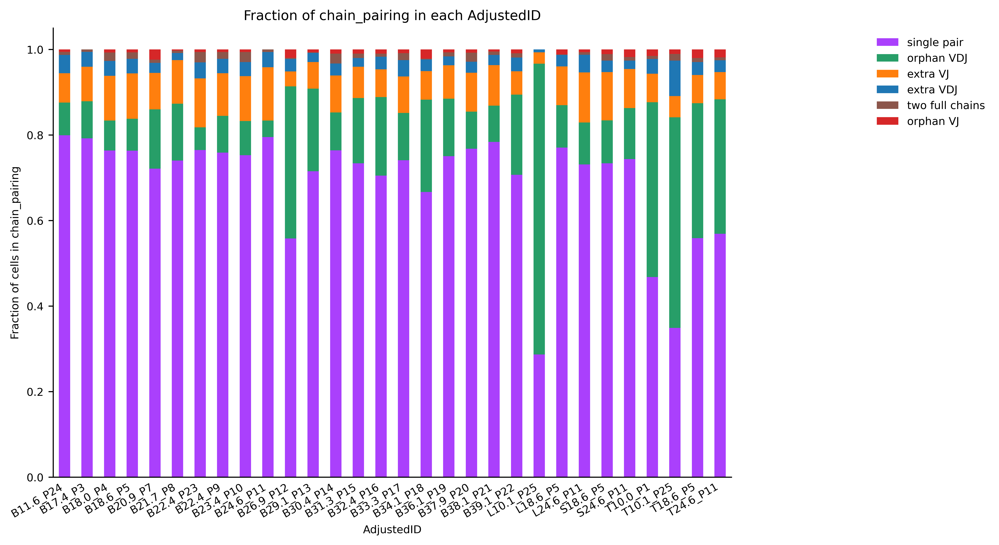

In [25]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
_ = ir.pl.group_abundance(
    adata_tcr2, groupby="AdjustedID", target_col="chain_pairing", sort="alphabetical", normalize=True,fig_kws={"figsize": (9, 6)}
)

In [26]:
mkdir -p /home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/TCRFigure

In [27]:
abundance_AdjustedID=ir.tl.group_abundance(
    adata_tcr2, groupby="AdjustedID", target_col="chain_pairing", sort="alphabetical"
)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.1     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.4.3     ✔ tibble    3.2.1
✔ lubridate 1.9.2     ✔ tidyr     1.3.0
✔ purrr     1.0.1     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors


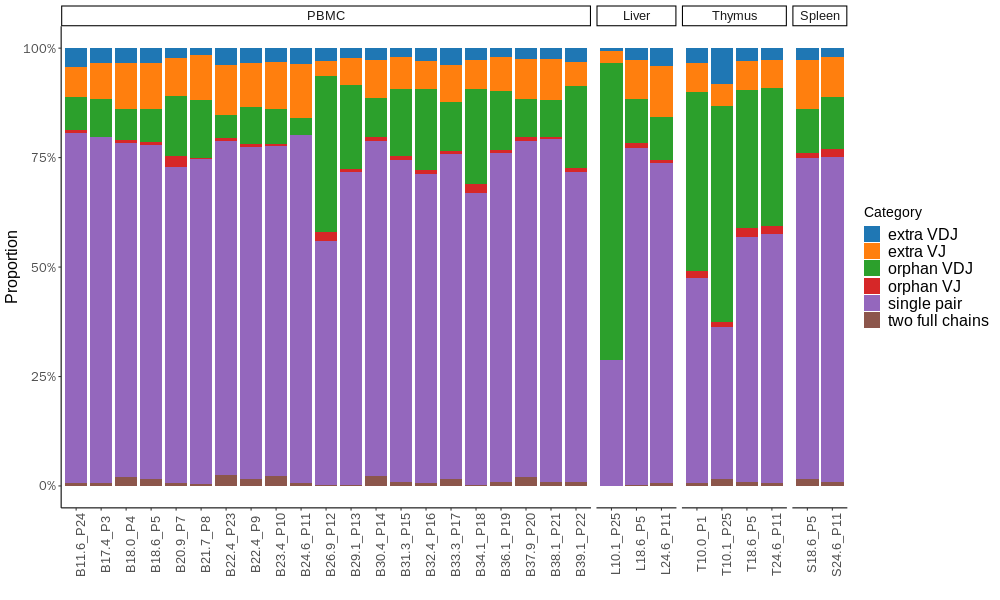

In [28]:
%%R -i  abundance_AdjustedID -w 1000 -h 600
library(tidyverse)
library(ggplot2)
library(ggsci)

# plot_proportions <- function(data, output_file) {
  data_prop <- abundance_AdjustedID %>% rownames_to_column(var = "tissue") %>%
    mutate(total = rowSums(.[, -1])) %>%
    mutate(across(starts_with("single") | starts_with("orphan") | starts_with("extra") | starts_with("two"), ~ . / total, .names = "prop_{.col}"))
  data_prop 
  data_long <- data_prop %>%
    select(tissue, starts_with("prop")) %>%
    pivot_longer(cols = starts_with("prop"),
                 names_to = "category",
                 values_to = "proportion") %>%
    mutate(category = str_remove(category, "prop_"))
  data_long
#   data_long$tissue <- factor(data_long$tissue, level = c('PBMC', 'Liver', 'Thymus', 'Spleen'))
  library(dplyr)
library(stringr)

data_long$Organ <- str_sub(data_long$tissue, 1, 1)


data_long <- data_long %>%
  mutate(Organ = case_when(
    Organ == "B" ~ "PBMC",
    Organ == "L" ~ "Liver",
    Organ == "S" ~ "Spleen",
    Organ == "T" ~ "Thymus"
  ))
data_long$Organ<-factor(data_long$Organ,level=c('PBMC','Liver','Thymus','Spleen'))
Ppcen_sample <- ggplot(data_long, aes(x = tissue, y = proportion, fill = category)) +
  geom_col() +
  scale_y_continuous(labels = scales::percent) +
  labs(x = "Tissue", y = "Proportion", fill = "Category") +
  theme_classic() +
  xlab('') +
  theme(text = element_text(size = 16),
        legend.position = "right",
        legend.title = element_text(size = 14),
        legend.text = element_text(size = 16),
        axis.text.x = element_text(angle = 90)) +
  scale_fill_d3() +
    facet_grid(. ~ Organ, space = "free", scales = "free", switch = "y")  

print(Ppcen_sample)
 Ppcen_sample 
  ggsave(plot = Ppcen_sample, filename ='/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/TCRFigure/TCRF2_allsamplepercentage.pdf', width = 12, height = 5)
  
#   return(Ppcen)
# }


# plot_proportions(abundance_AdjustedID, "/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/TCRFigure/TCRF2_allsamplepercentage.pdf")


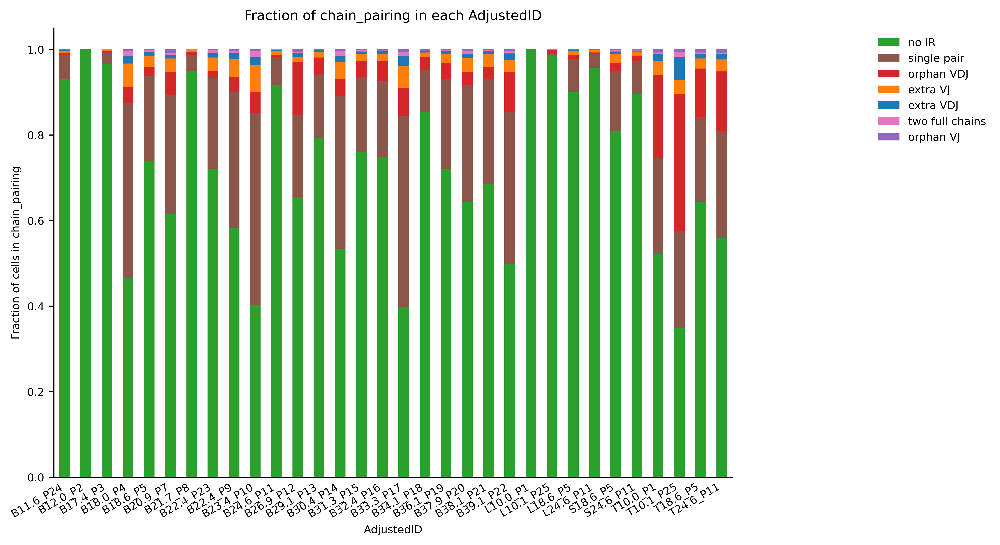

In [29]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
_ = ir.pl.group_abundance(
    adata1, groupby="AdjustedID", target_col="chain_pairing", sort="alphabetical", normalize=True,fig_kws={"figsize": (9, 6)}
)

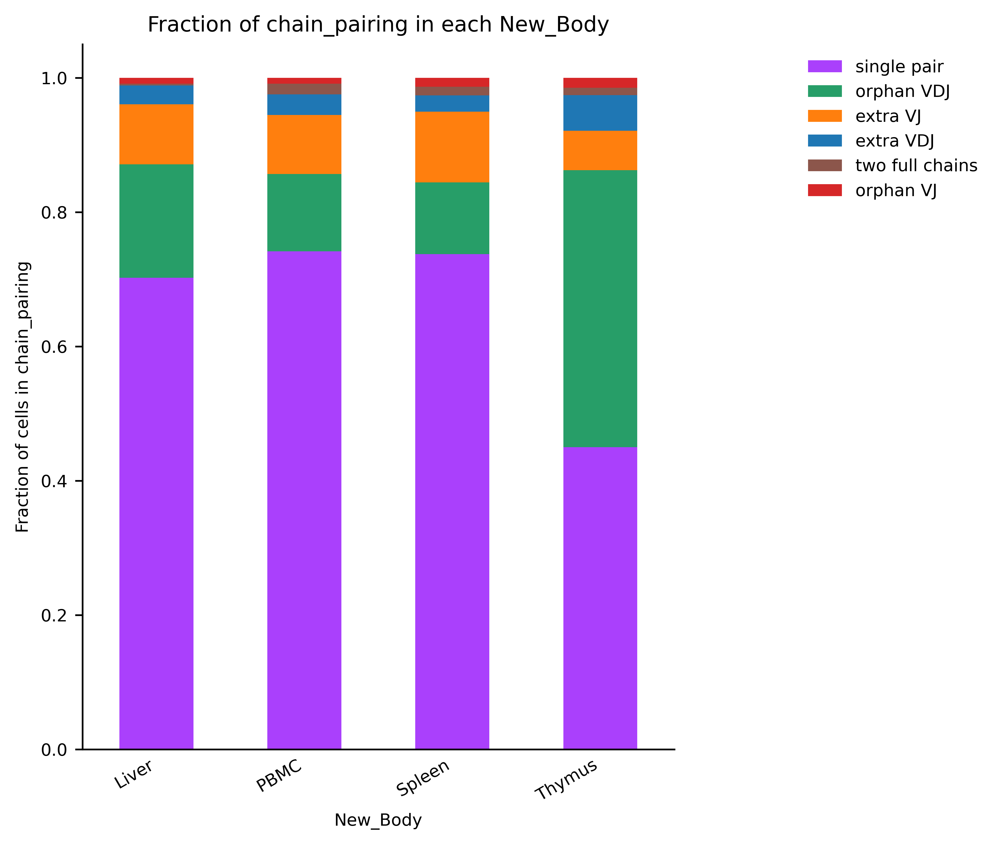

In [30]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 3]
plt.rcParams['figure.dpi'] = 300
_ = ir.pl.group_abundance(
    adata_tcr2, groupby="New_Body", target_col="chain_pairing", sort="alphabetical", normalize=True,fig_kws={"figsize": (5, 6)}
)

In [31]:
testabundance = ir.tl.group_abundance(
    adata1_IR, groupby="New_Body", target_col="chain_pairing", sort="alphabetical"
)

In [32]:
testabundance 

chain_pairing,single pair,orphan VDJ,extra VJ,extra VDJ,two full chains,orphan VJ
New_Body,,,,,,
Liver,872.0,210.0,111.0,35.0,3.0,11.0
PBMC,39727.0,6173.0,4710.0,1648.0,836.0,477.0
Spleen,2004.0,291.0,286.0,66.0,35.0,36.0
Thymus,6259.0,5732.0,818.0,739.0,152.0,204.0


In [33]:
mkdir -p /home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/TCRFigure

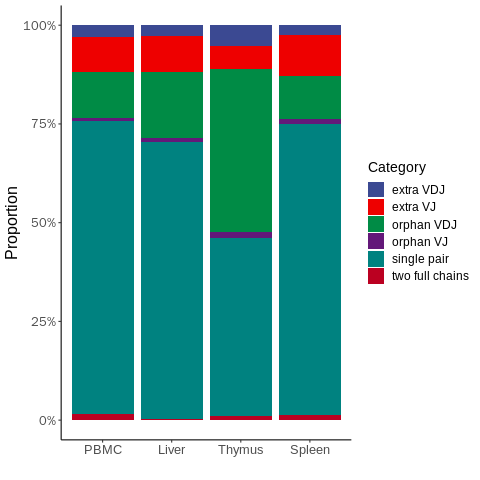

In [34]:
%%R -i testabundance 
testabundance 
library(tidyverse)
library(ggplot2)
# ggplot(testabundance)+geom()
# testabundance_wide <- testabundance %>%rownames_to_column(var = "group") %>%
#   mutate(total = rowSums(.[, -1])) %>% mutate(across(starts_with("Species"), ~ . / total, .names = "prop_{.col}"))
# #   spread()
# testabundance_wide
data_prop <- testabundance  %>% rownames_to_column(var = "tissue") %>%
  mutate(total = rowSums(.[, -1])) %>%
  mutate(across(starts_with("single") | starts_with("orphan") | starts_with("extra") | starts_with("two"), ~ . / total, .names = "prop_{.col}"))
# data_long
# testabundance$ 
library(ggsci)
data_long <- data_prop %>%
  select(tissue, starts_with("prop")) %>%
  pivot_longer(cols = starts_with("prop"),
               names_to = "category",
               values_to = "proportion") %>%
  mutate(category = str_remove(category, "prop_"))
unique(data_long$tissue)
data_long$tissue<-factor(data_long$tissue,level=c('PBMC','Liver','Thymus','Spleen'))
Ppcen=ggplot(data_long, aes(x = tissue, y = proportion, fill = category)) +
  geom_col() +
  scale_y_continuous(labels = scales::percent) +
  labs(x = "Tissue", y = "Proportion", fill = "Category") +
  theme_classic() +xlab('')+
  theme(text = element_text(size = 16),
        legend.position = "right",
        legend.title = element_text(size = 14),
        legend.text = element_text(size = 12))+scale_fill_aaas()

ggsave(plot=Ppcen,'/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/TCRFigure/TCRF1.pdf',width=6,height=5)
Ppcen

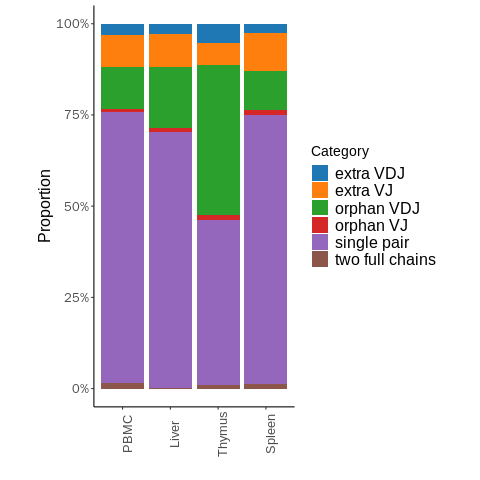

In [35]:
%%R -i testabundance 
library(tidyverse)
library(ggplot2)
library(ggsci)

plot_proportions <- function(data, output_file) {
  data_prop <- data %>% rownames_to_column(var = "tissue") %>%
    mutate(total = rowSums(.[, -1])) %>%
    mutate(across(starts_with("single") | starts_with("orphan") | starts_with("extra") | starts_with("two"), ~ . / total, .names = "prop_{.col}"))
  
  data_long <- data_prop %>%
    select(tissue, starts_with("prop")) %>%
    pivot_longer(cols = starts_with("prop"),
                 names_to = "category",
                 values_to = "proportion") %>%
    mutate(category = str_remove(category, "prop_"))
  
  data_long$tissue <- factor(data_long$tissue, level = c('PBMC', 'Liver', 'Thymus', 'Spleen'))
  
  Ppcen <- ggplot(data_long, aes(x = tissue, y = proportion, fill = category)) +
    geom_col() +
    scale_y_continuous(labels = scales::percent) +
    labs(x = "Tissue", y = "Proportion", fill = "Category") +
    theme_classic() +
    xlab('') +
    theme(text = element_text(size = 16),
          legend.position = "right",
          legend.title = element_text(size = 14),
          legend.text = element_text(size = 16),
          axis.text.x=element_text(angle=90),
         aspect.ratio = 2) +
    scale_fill_d3()
  
  ggsave(plot = Ppcen, filename = output_file, width = 6, height = 5)
  
  return(Ppcen)
}

# 使用函数绘制图像并保存为 PDF
plot_proportions(testabundance, "/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/TCRFigure/TCRF1.pdf")

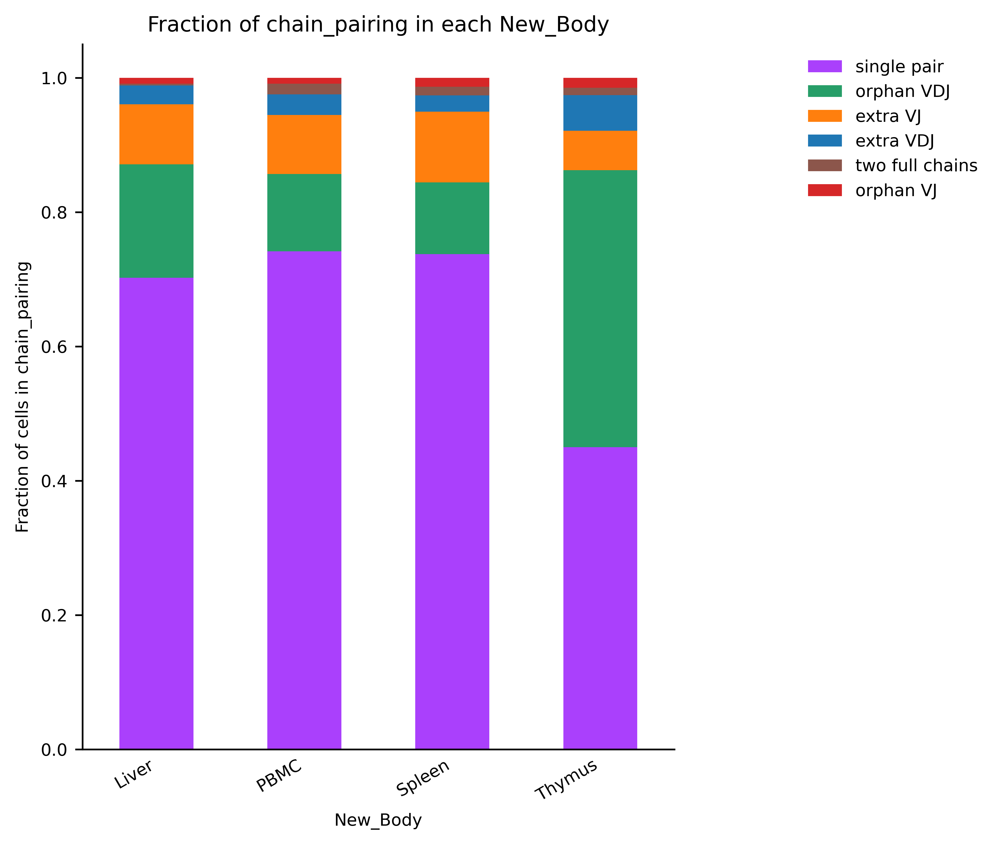

In [36]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 3]
plt.rcParams['figure.dpi'] = 300
datatest1= ir.pl.group_abundance(
    adata1_IR, groupby="New_Body", target_col="chain_pairing", sort="alphabetical", normalize=True,fig_kws={"figsize": (5, 6)}
)

In [37]:
datatest1

<Axes: title={'center': 'Fraction of chain_pairing in each New_Body'}, xlabel='New_Body', ylabel='Fraction of cells in chain_pairing'>

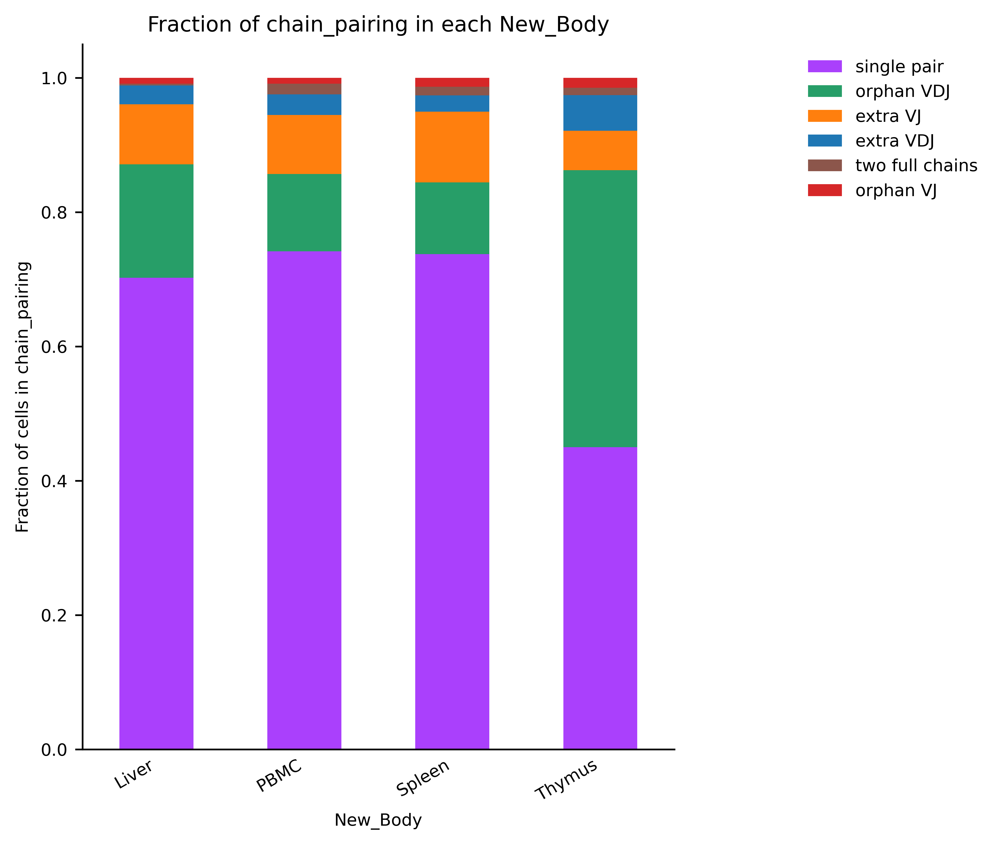

In [38]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 3]
plt.rcParams['figure.dpi'] = 300
_ = ir.pl.group_abundance(
    adata1_IR, groupby="New_Body", target_col="chain_pairing", sort="alphabetical", normalize=True,fig_kws={"figsize": (5, 6)}
)

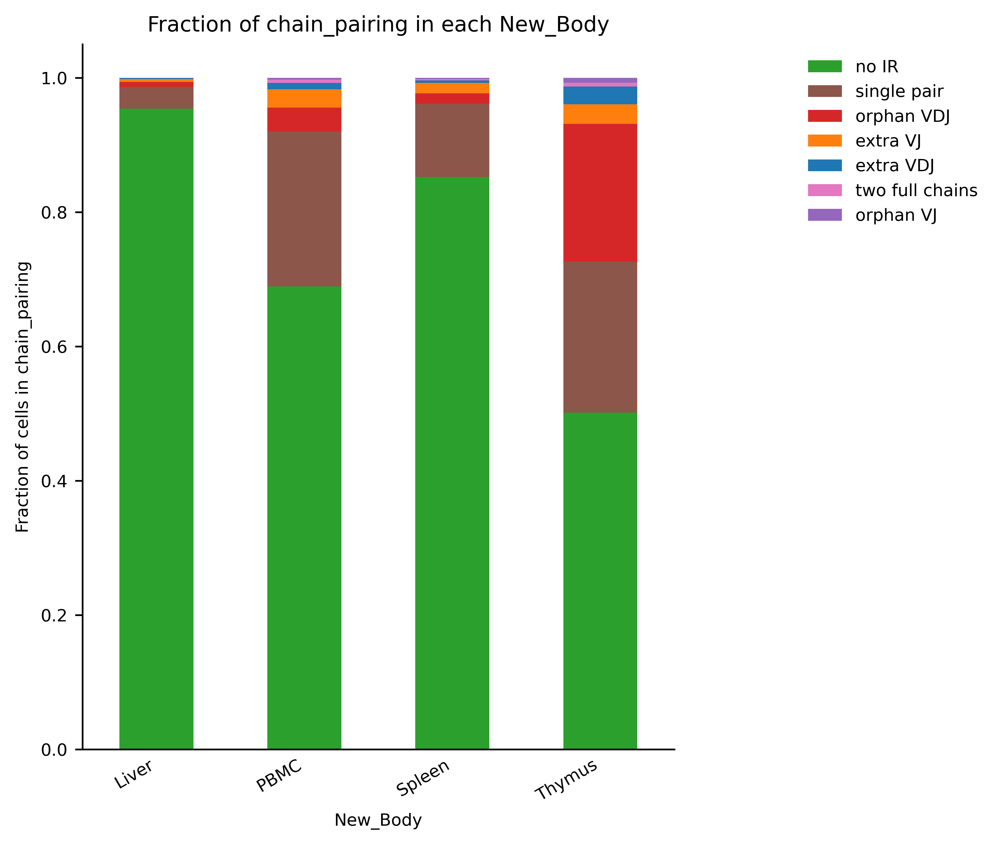

In [39]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 3]
plt.rcParams['figure.dpi'] = 300
_ = ir.pl.group_abundance(
    adata1, groupby="New_Body", target_col="chain_pairing", sort="alphabetical", normalize=True,fig_kws={"figsize": (5, 6)}
)

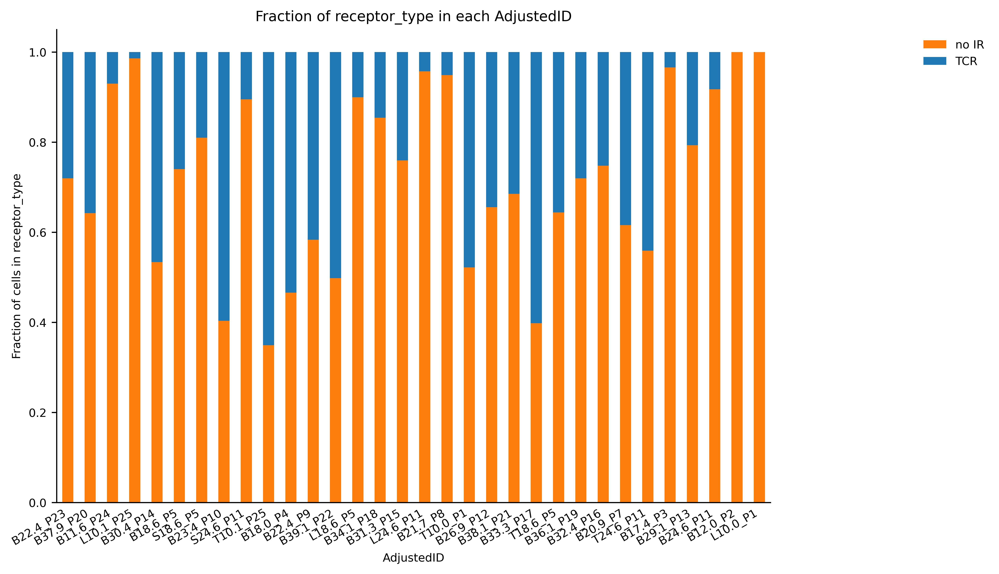

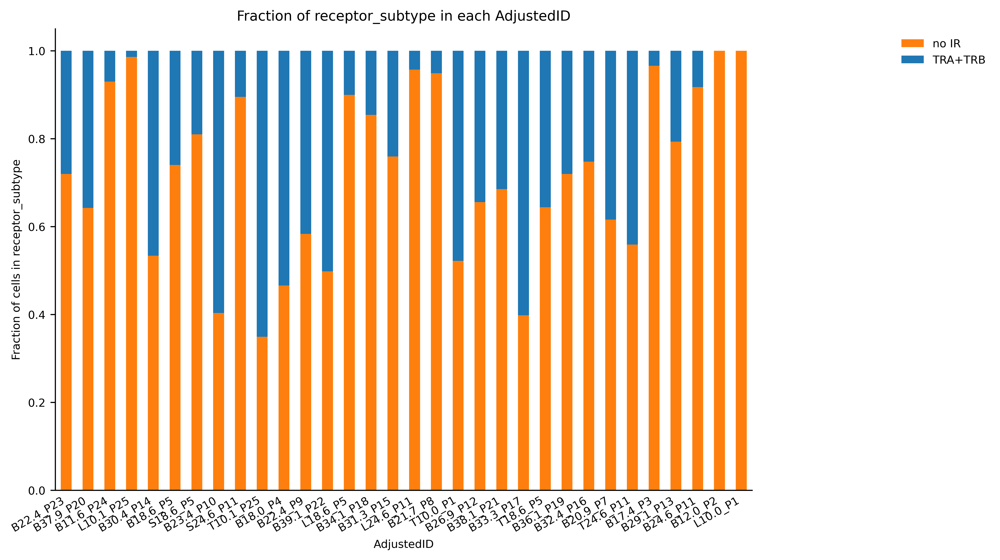

In [40]:
_ = ir.pl.group_abundance(
    adata1, groupby="AdjustedID", target_col="receptor_type", normalize=True,fig_kws={"figsize": (9, 6)}
)
_ = ir.pl.group_abundance(
    adata1, groupby="AdjustedID", target_col="receptor_subtype", normalize=True,fig_kws={"figsize": (9, 6)}
)

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


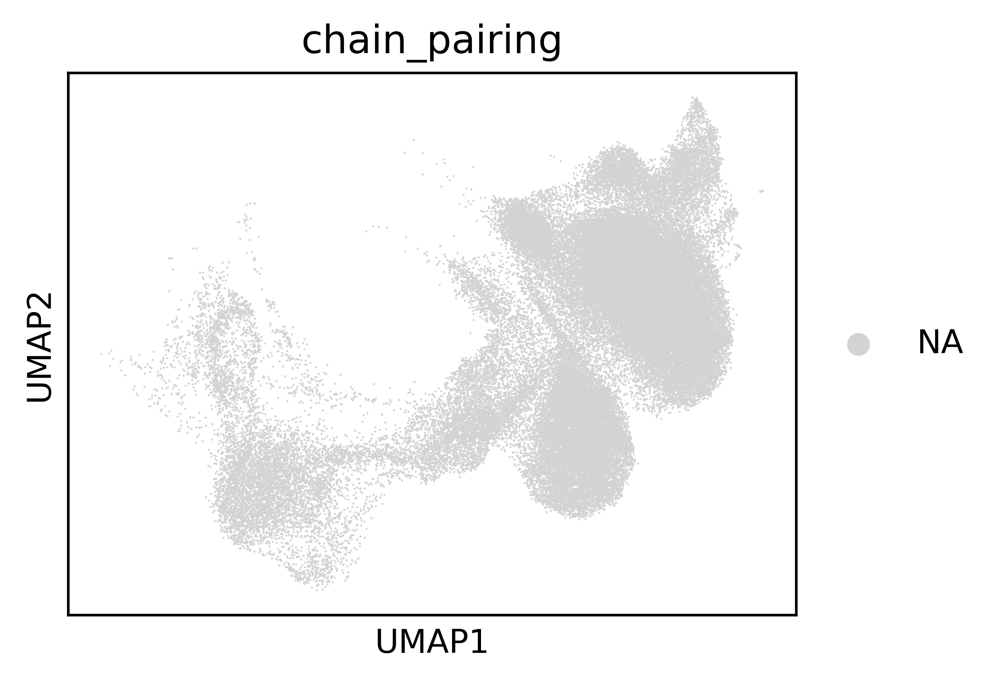

In [41]:
sc.pl.umap(adata1_IR, color="chain_pairing", groups="multichain")

In [42]:
adata1_IR.obs["chain_pairing"]

Cellname
Z48_AAAGCAACATGACGGA-1       extra VDJ
Z48_AACCGCGGTTGGTGGA-1     single pair
Z48_AACCGCGTCCAAACTG-1     single pair
Z48_AACTCAGAGGTGCAAC-1     single pair
Z48_AACTTTCAGACATAAC-1     single pair
                              ...     
Z123_TTTGTCACACTGTTAG-1    single pair
Z123_TTTGTCACATTTGCTT-1    single pair
Z123_TTTGTCAGTAAGTGTA-1    single pair
Z123_TTTGTCAGTACCGTAT-1      extra VDJ
Z123_TTTGTCATCTACTTAC-1    single pair
Name: chain_pairing, Length: 71435, dtype: category
Categories (6, object): ['extra VDJ', 'extra VJ', 'orphan VDJ', 'orphan VJ', 'single pair', 'two full chains']

In [43]:
adata= adata1_IR[adata1_IR.obs["chain_pairing"] != "multichain", :].copy()
adata = adata[~adata.obs["chain_pairing"].isin(["orphan VDJ", "orphan VJ"]), :].copy()


In [44]:
# adata= adata[adata.obs['cell_type'].str.contains('T')]
# adata1_IR2=adata1_IR[adata1_IR.obs['cell_type'].str.contains('T')]

In [45]:
# adata= adata[adata.obs['cell_type'].str.contains('T')]
# adata1_IR3=adata1[adata1.obs['cell_type'].str.contains('T')]

In [46]:
# adataR_VDJ_1_junction_aa

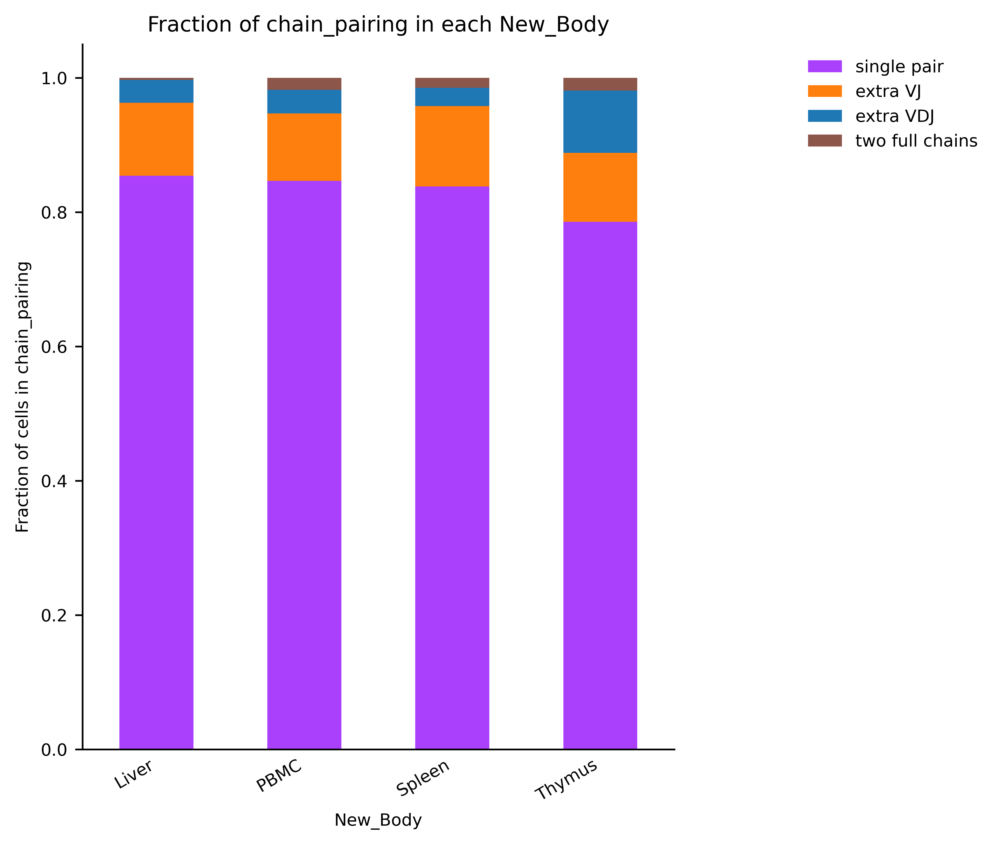

In [47]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 3]
plt.rcParams['figure.dpi'] = 300
_ = ir.pl.group_abundance(
    adata, groupby="New_Body", target_col="chain_pairing", sort="alphabetical", normalize=True,fig_kws={"figsize": (5, 6)}
)

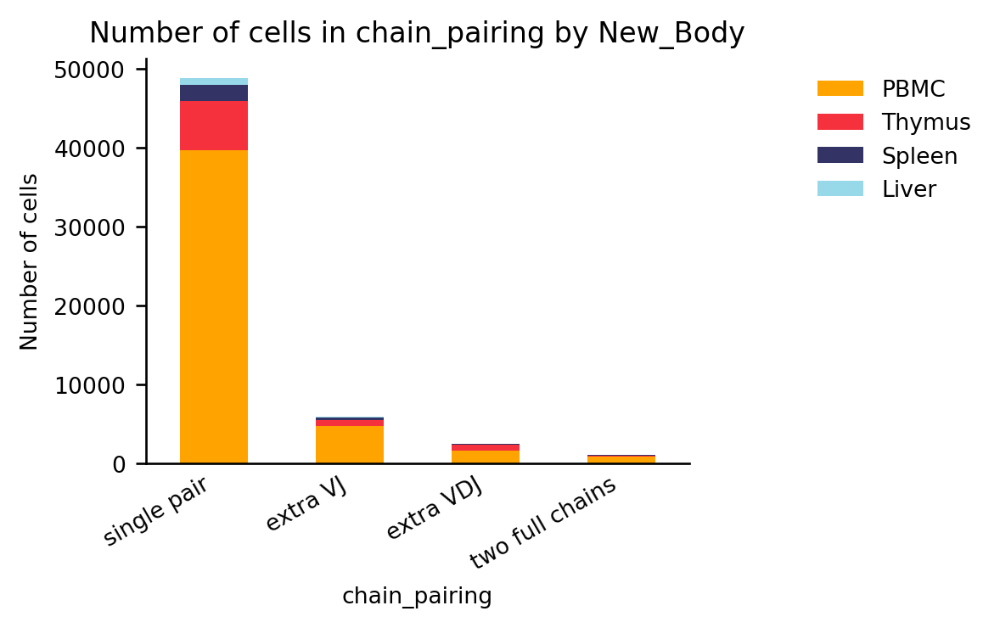

In [48]:
ax = ir.pl.group_abundance(adata, groupby="chain_pairing", target_col="New_Body")

In [49]:
# adata1_IR.obs['cell_type'].value_counts()

In [50]:
# sc.pl.umap(adata1_IR, color="cell_type")

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


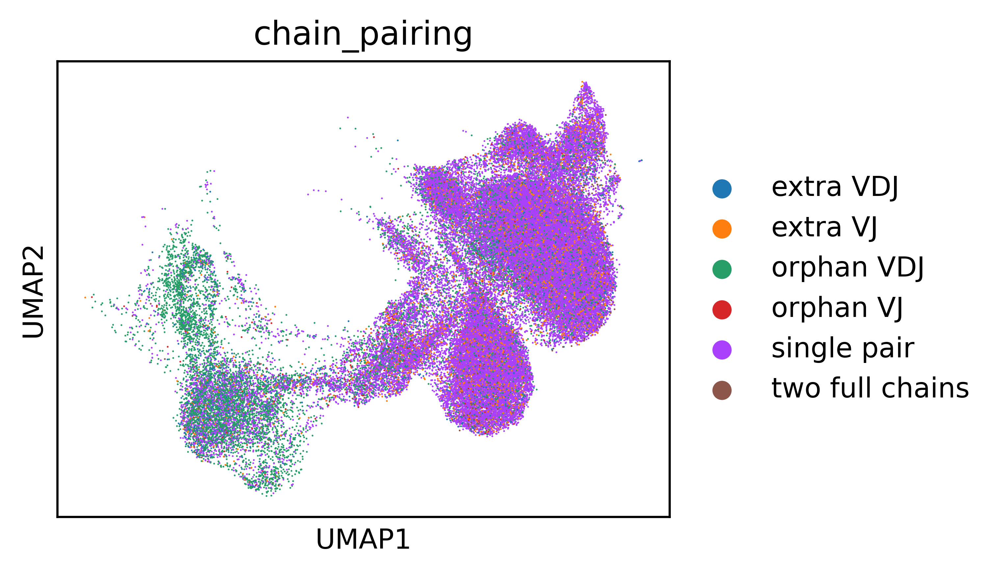

In [51]:
sc.pl.umap(adata1_IR, color="chain_pairing")

In [52]:
# sc.pl.umap(adata1_IR3, color="chain_pairing")

In [53]:
adata1.obs["chain_pairing"].value_counts()

no IR              174399
single pair         48862
orphan VDJ          12406
extra VJ             5925
extra VDJ            2488
two full chains      1026
orphan VJ             728
Name: chain_pairing, dtype: int64

In [54]:
ir.pp.ir_dist(adata_tcr2, sequence="aa")
ir.pp.ir_dist(adata1_IR, sequence="aa")
ir.pp.ir_dist(adata, sequence="aa")

Computing sequence x sequence distance matrix for VJ sequences.
Computing sequence x sequence distance matrix for VDJ sequences.
Computing sequence x sequence distance matrix for VJ sequences.
Computing sequence x sequence distance matrix for VDJ sequences.
Computing sequence x sequence distance matrix for VJ sequences.
Computing sequence x sequence distance matrix for VDJ sequences.


In [55]:
# @@@

In [56]:
ir.tl.define_clonotypes(adata_tcr2, receptor_arms="all", dual_ir="primary_only")

ir_dist for sequence='nt' and metric='identity' not found. Computing with default parameters.
Computing sequence x sequence distance matrix for VJ sequences.
Computing sequence x sequence distance matrix for VDJ sequences.
Initializing lookup tables. 
Computing clonotype x clonotype distances.
NB: Computation happens in chunks. The progressbar only advances when a chunk has finished. 


  0%|          | 0/76893 [00:03<?, ?it/s]

Stored clonal assignments in `adata.obs["clone_id"]`.


In [57]:
ir.tl.define_clonotypes(adata, receptor_arms="all", dual_ir="primary_only")

ir_dist for sequence='nt' and metric='identity' not found. Computing with default parameters.
Computing sequence x sequence distance matrix for VJ sequences.
Computing sequence x sequence distance matrix for VDJ sequences.
Initializing lookup tables. 
Computing clonotype x clonotype distances.
NB: Computation happens in chunks. The progressbar only advances when a chunk has finished. 


  0%|          | 0/57960 [00:02<?, ?it/s]

Stored clonal assignments in `adata.obs["clone_id"]`.


In [58]:
ir.tl.define_clonotypes(adata1_IR, receptor_arms="all", dual_ir="primary_only")

ir_dist for sequence='nt' and metric='identity' not found. Computing with default parameters.
Computing sequence x sequence distance matrix for VJ sequences.
Computing sequence x sequence distance matrix for VDJ sequences.
Initializing lookup tables. 
Computing clonotype x clonotype distances.
NB: Computation happens in chunks. The progressbar only advances when a chunk has finished. 


  0%|          | 0/70105 [00:02<?, ?it/s]

Stored clonal assignments in `adata.obs["clone_id"]`.


In [59]:
ir.tl.define_clonotype_clusters(
    adata_tcr2, sequence="aa", receptor_arms="all", dual_ir="primary_only"
)

Initializing lookup tables. 
Computing clonotype x clonotype distances.
NB: Computation happens in chunks. The progressbar only advances when a chunk has finished. 


  0%|          | 0/75859 [00:01<?, ?it/s]

Stored clonal assignments in `adata.obs["cc_aa_identity"]`.


In [60]:
ir.tl.define_clonotype_clusters(
    adata1_IR, sequence="aa", receptor_arms="all", dual_ir="primary_only"
)

Initializing lookup tables. 
Computing clonotype x clonotype distances.
NB: Computation happens in chunks. The progressbar only advances when a chunk has finished. 


  0%|          | 0/69142 [00:00<?, ?it/s]

Stored clonal assignments in `adata.obs["cc_aa_identity"]`.


In [61]:
ir.tl.clonotype_network(adata, min_cells=2)

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: title={'center': 'New_Body'}, xlabel='UMAP1', ylabel='UMAP2'>

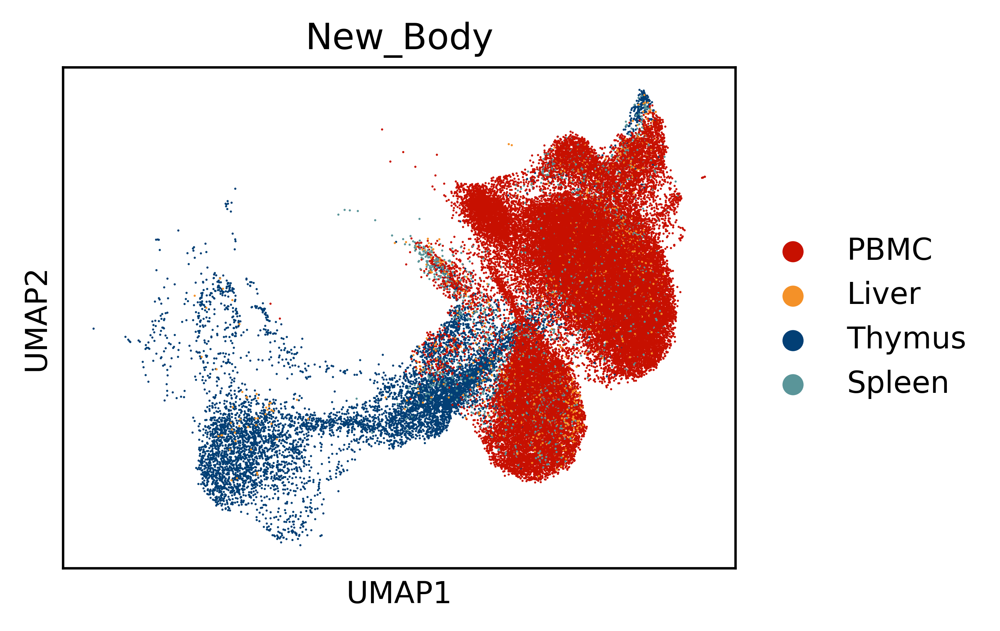

In [62]:
import pandas as pd

adata.obs['New_Body'] = pd.Categorical(adata.obs['New_Body'], 
                                        categories=["PBMC", "Liver", "Thymus", "Spleen"], 
                                        ordered=True)

sc.pl.umap(adata, color='New_Body', palette=['#C71000FF',"#f49128","#023f75","#5A9599FF"],show=False)

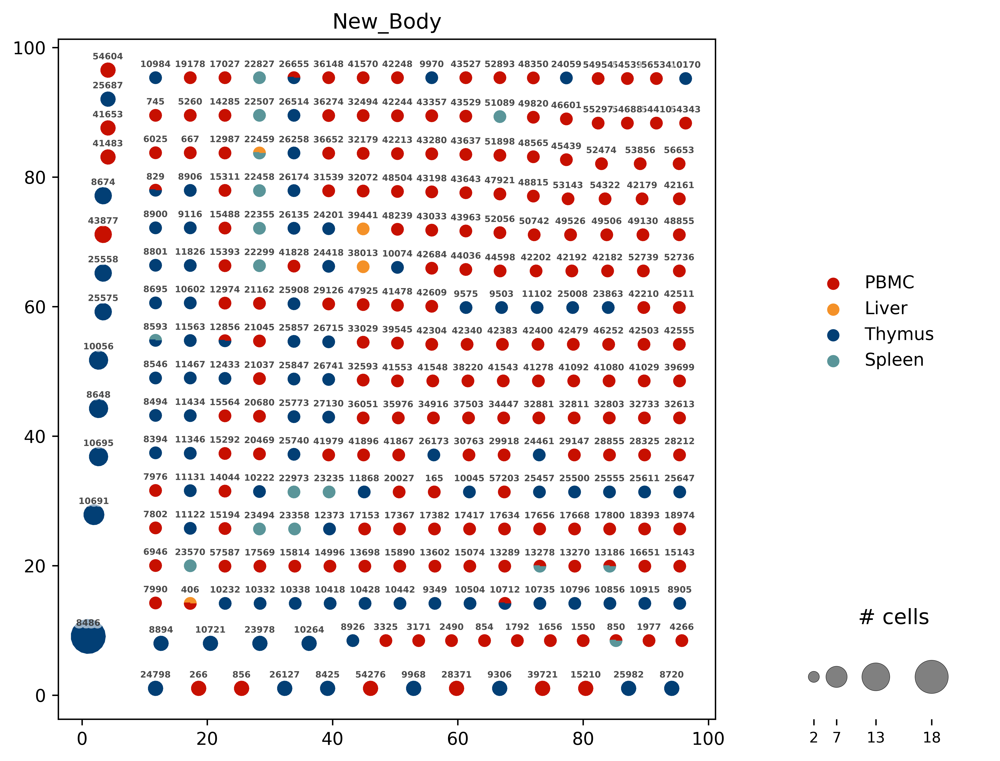

In [63]:
ir.pl.clonotype_network(
    adata, color="New_Body", base_size=20, label_fontsize=5, panel_size=(7, 7)
)
plt.savefig("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure4/S29/S29A_clone_Organ.pdf")

In [64]:
ir.pp.ir_dist(
    adata,
    metric="alignment",
    sequence="aa",
    cutoff=15,
)

Computing sequence x sequence distance matrix for VJ sequences.


  0%|          | 0/355746 [00:00<?, ?it/s]

Computing sequence x sequence distance matrix for VDJ sequences.


  0%|          | 0/441330 [00:00<?, ?it/s]

In [65]:
ir.tl.define_clonotype_clusters(
    adata, sequence="aa", metric="alignment", receptor_arms="all", dual_ir="any"
)

Initializing lookup tables. 
Computing clonotype x clonotype distances.
NB: Computation happens in chunks. The progressbar only advances when a chunk has finished. 


  0%|          | 0/57994 [00:01<?, ?it/s]

Stored clonal assignments in `adata.obs["cc_aa_alignment"]`.


In [66]:
mkdir -p /home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure4/S29

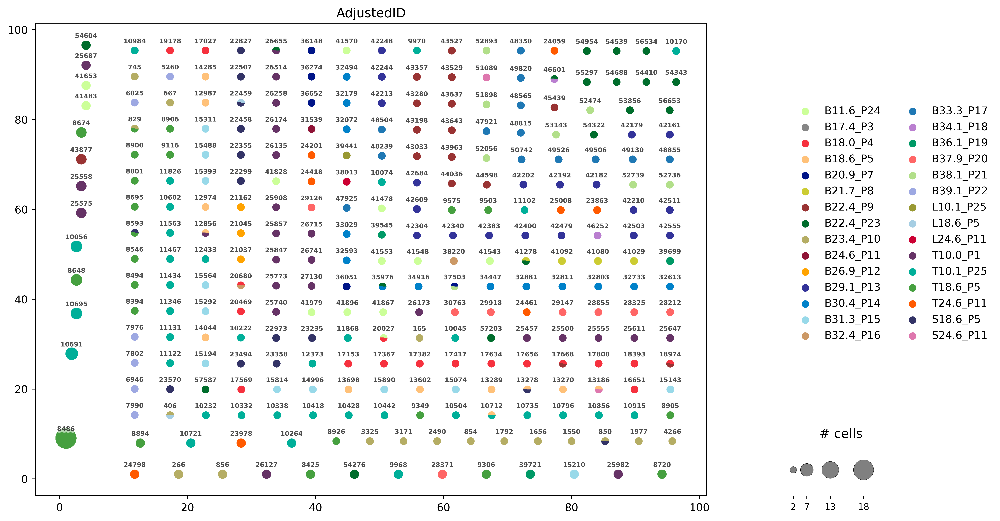

In [67]:
ir.pl.clonotype_network(
    adata, color="AdjustedID", label_fontsize=6, panel_size=(12, 8), base_size=20
)
plt.savefig("/home/maolp/Main_Gao_ScanpyProject20231130/HFB_Figure_Plot/Sup_Figure4/S29/S29A_clone_ID.pdf")

In [68]:
adata.obs.loc[adata.obs["cc_aa_alignment"] == "8486", :]

,Name,doublet_scores,predicted_doublets,predicted_labels,over_clustering,majority_voting,conf_score,Cellname,AdjustedID,New_Body,...,IR_VDJ_1_v_call,IR_VDJ_2_v_call,has_ir,receptor_type,receptor_subtype,chain_pairing,clone_id,clone_id_size,cc_aa_alignment,cc_aa_alignment_size
Cellname,,,,,,,,,,,,,,,,,,,,,
D36_GAACCTATCCAATGGT-1,D36,0.128329,False,Double-positive thymocytes,117,Double-positive thymocytes,1.0,D36_GAACCTATCCAATGGT-1,T10.1_P25,Thymus,...,TRBV19,NaN,True,TCR,TRA+TRB,single pair,11426,1,8486,1


In [69]:
ir.tl.chain_qc(adata)

In [70]:
# adata.obs

In [71]:
# adata.obs.loc[adata.obs["clone_id"] == "8563", :][
#     [
#         "IR_VJ_1_junction_aa",
#         "IR_VJ_2_junction_aa",
#         "IR_VDJ_1_junction_aa",
#         "IR_VDJ_2_junction_aa",
#         "receptor_subtype",
#     ]]

In [72]:
ir.tl.define_clonotype_clusters(
    adata,
    sequence="aa",
    metric="alignment",
    receptor_arms="all",
    dual_ir="any",
    same_v_gene=True,
    key_added="cc_aa_alignment_same_v",
)

Initializing lookup tables. 
Computing clonotype x clonotype distances.
NB: Computation happens in chunks. The progressbar only advances when a chunk has finished. 


  0%|          | 0/58007 [00:00<?, ?it/s]

Stored clonal assignments in `adata.obs["cc_aa_alignment_same_v"]`.


In [73]:
ir.tl.clonal_expansion(adata)

In [74]:
ir.tl.clonal_expansion(adata)

In [75]:
adata.obs[adata.obs[ "clone_id_size"]>18]

,Name,doublet_scores,predicted_doublets,predicted_labels,over_clustering,majority_voting,conf_score,Cellname,AdjustedID,New_Body,...,receptor_type,receptor_subtype,chain_pairing,clone_id,clone_id_size,cc_aa_alignment,cc_aa_alignment_size,cc_aa_alignment_same_v,cc_aa_alignment_same_v_size,clonal_expansion
Cellname,,,,,,,,,,,,,,,,,,,,,


/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


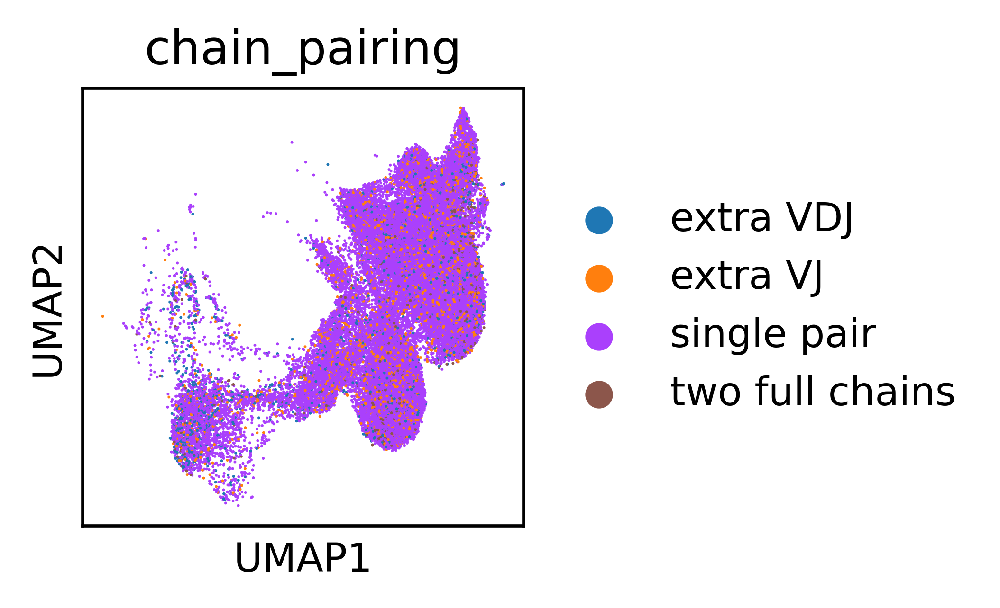

In [76]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color=["chain_pairing"])

In [77]:
# adata[adata.obs.str.contains(' NK')]

In [78]:
# adata1_IR.obs['cell_type'].value_counts()


In [79]:
# Othes=adata1_IR[adata1_IR.obs['cell_type'].isin(adata1_IR.obs['cell_type'].value_counts()[adata1_IR.obs['cell_type'].value_counts()<30].index.to_list()
#                                               )]

In [80]:
# Othes

In [81]:
# Othes.obs['cell_type']='Others'

In [82]:
# adata1_IR.obs.update(Othes.obs[['cell_type']])

In [83]:
# adata1.obs.update(Othes.obs[['cell_type']])

In [84]:
# sc.pl.umap(adata1_IR, color=["chain_pairing",'cell_type'])

In [85]:
def create_palette(cell_types, colors):
    cell_type_colors = {}
    for i, cell_type in enumerate(cell_types):
        color = colors[i % len(colors)]
        cell_type_colors[cell_type] = color
    return cell_type_colors
colorname2=["#46A040" ,"#00AF99", "#FFC179" ,"#98D9E9" ,"#F6313E", "#FFA300", "#333366", "#FF5A00", "#663366","#FF6666",
"#8F1336", "#0081C9", "#001588", "#CC0033","#CC9966","#CC0033","#999933","#009966","#CCCC33","#CCFF99","#333399","#993333",
"#490C65", "#BA7FD0","#A6CEE3", "#1F78B4", "#DE77AE", "#B2DF8A", "#006D2C", "#868686", "#B5AD64","#9DA8E2","#91C392","#FF9900","#339966"]

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


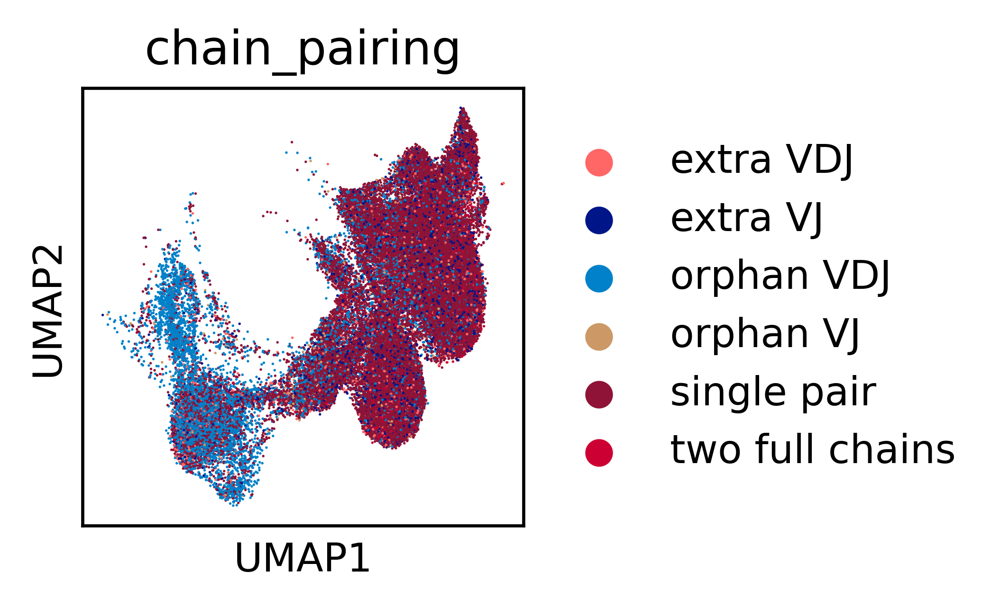

In [86]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata1_IR, color=["chain_pairing"],palette=create_palette(adata1.obs["chain_pairing"].unique(),colorname2[8:16]),)

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


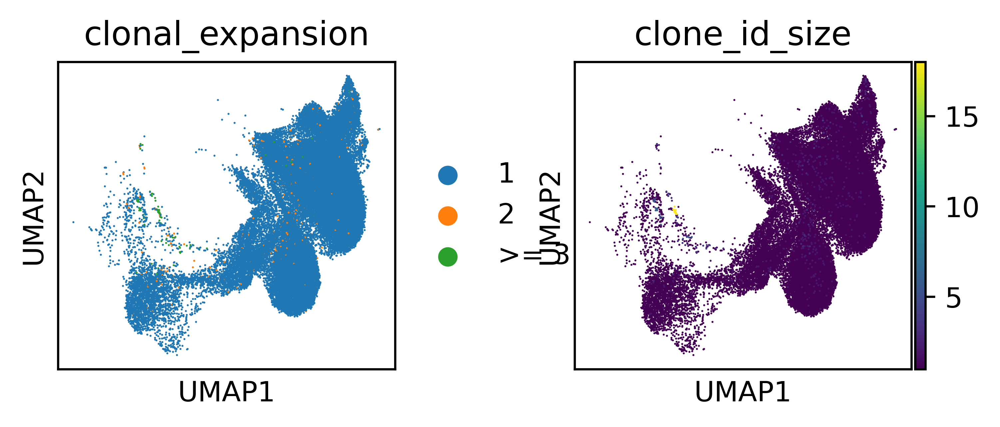

In [87]:
sc.pl.umap(adata, color=["clonal_expansion", "clone_id_size"])

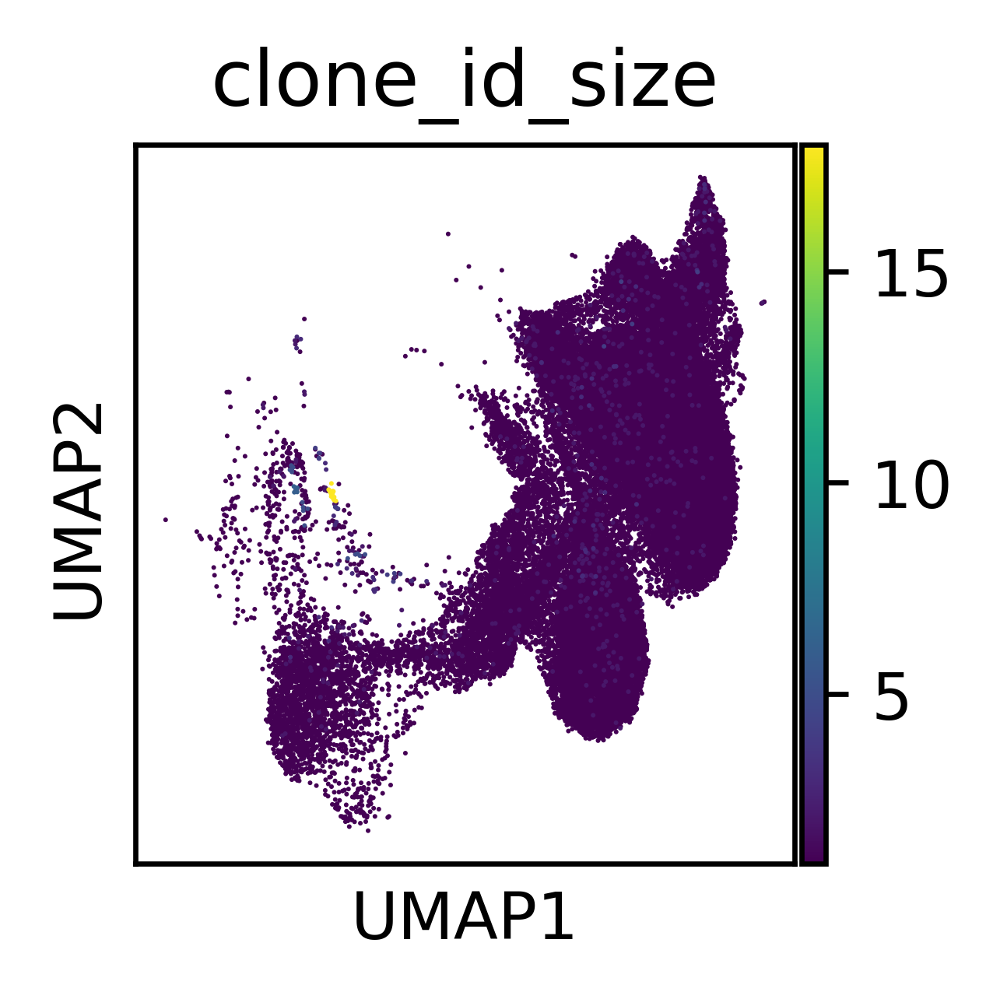

In [88]:
sc.pl.umap(adata, color=["clone_id_size"])

In [89]:
# ir.pl.clonal_expansion(adata, groupby="cell_type", clip_at=15, normalize=False, figsize=[10, 10],)

<Axes: >

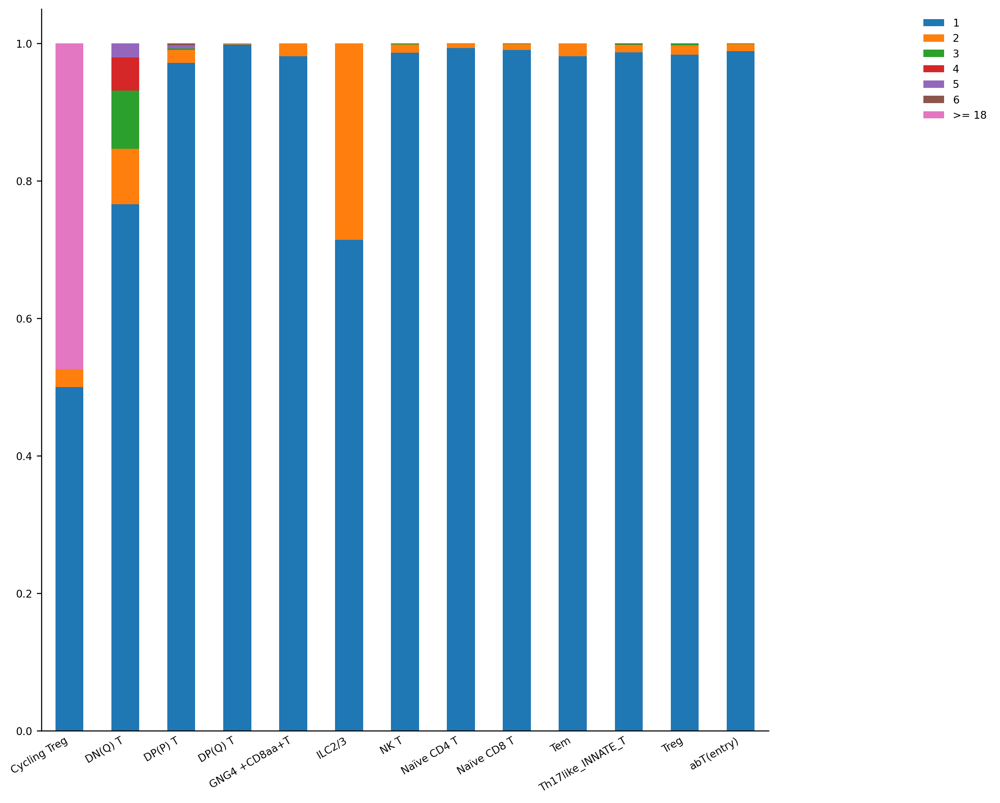

In [90]:
ir.pl.clonal_expansion(adata, "Last_cell_type",clip_at=18, figsize=[10, 10])

In [91]:
adata1_IR2=adata1_IR[adata1_IR.obs['Last_cell_type'].str.contains('T')]

<Axes: >

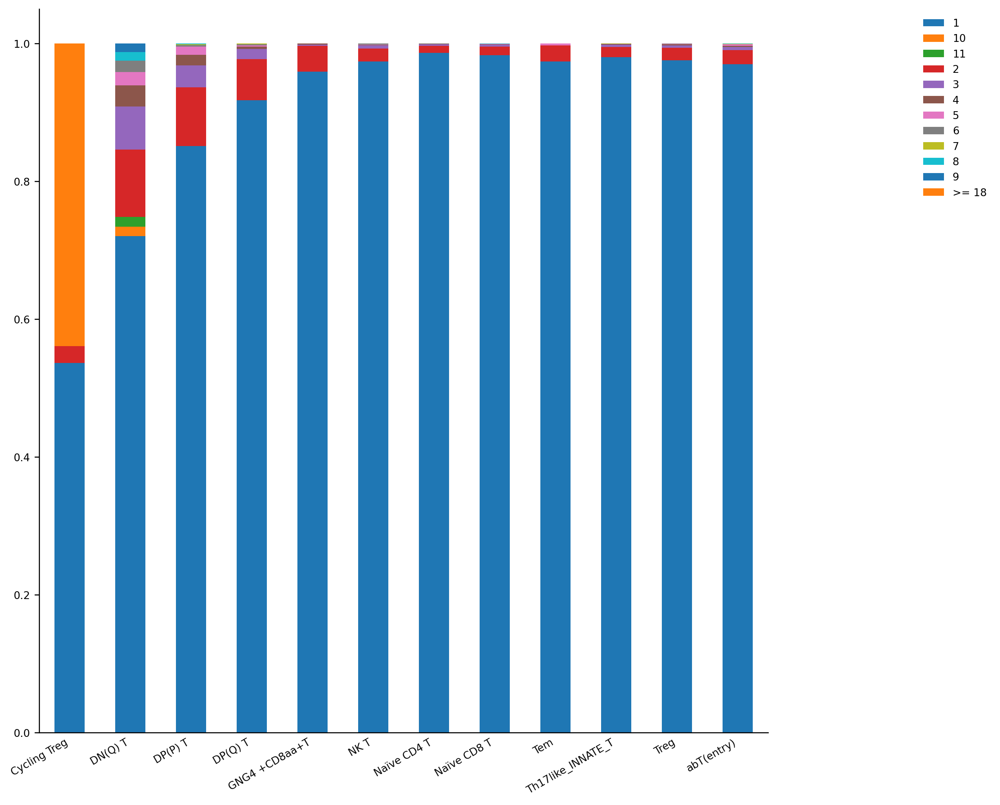

In [92]:
ir.pl.clonal_expansion(adata1_IR2, "Last_cell_type",clip_at=18, figsize=[10, 10])

In [93]:
adata

AnnData object with n_obs × n_vars = 58301 × 31424
    obs: 'Name', 'doublet_scores', 'predicted_doublets', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Cellname', 'AdjustedID', 'New_Body', 'Week', 'TCRBCRlabel', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Last_cell_type', 'Cell_lineage', 'Last_cell_type2', 'Last_cell_type_num', 'Last_cell_type_num2', 'is_cell', 'high_confidence', 'multi_chain', 'extra_chains', 'IR_VJ_1_c_call', 'IR_VJ_2_c_call', 'IR_VDJ_1_c_call', 'IR_VDJ_2_c_call', 'IR_VJ_1_consensus_count', 'IR_VJ_2_consensus_count', 'IR_VDJ_1_consensus_count', 'IR_VDJ_2_consensus_count', 'IR_VJ_1_d_call', 'IR_VJ_2_d_call', 'IR_VDJ_1_d_call', 'IR_VDJ_2_d_call', 'IR_VJ_1_duplicate_count', 'IR_VJ_2_duplicate_count', 'IR_VDJ_1_duplicate_count', 'IR_VDJ_2_duplicate_count', 'IR_VJ_1_j_call', 'IR_VJ_2_j_call', 'IR_VDJ_1_j_call', 'IR_VDJ_2_j_call', 'IR_VJ_1_junction', 'IR_VJ_2_junction', 'IR_VDJ_1_junction', 'IR

In [94]:
IDcolne=ir.tl.group_abundance(
    adata, groupby="clone_id", target_col="Last_cell_type"
)

In [95]:
# %%R -i IDcolne
# IDcolne[1:10,]

<Axes: title={'center': 'Fraction of Last_cell_type in each clone_id'}, xlabel='clone_id', ylabel='Fraction of cells in AdjustedID'>

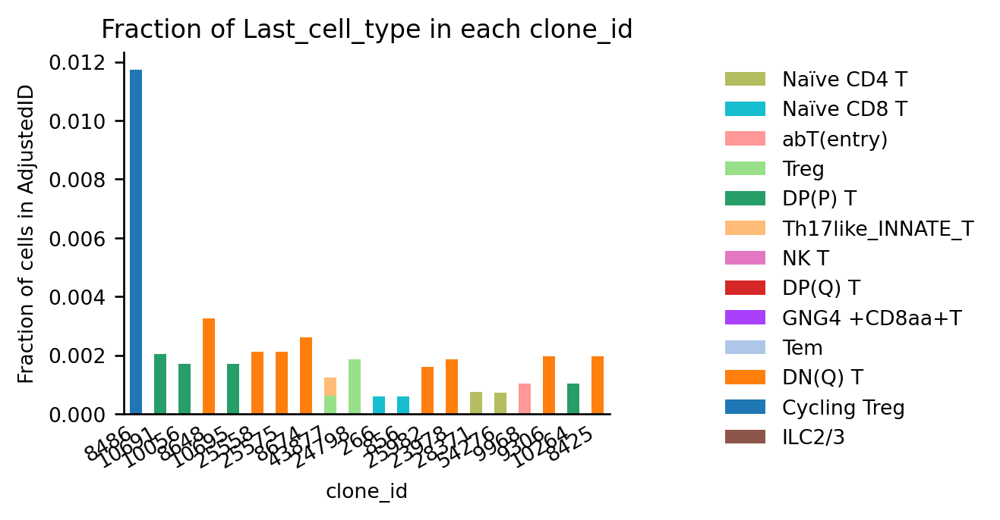

In [96]:
ir.pl.group_abundance(
    adata, groupby="clone_id", target_col="Last_cell_type", max_cols=20, normalize="AdjustedID"
)

In [97]:
adata.obs['cell_type']=adata.obs['Last_cell_type']

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


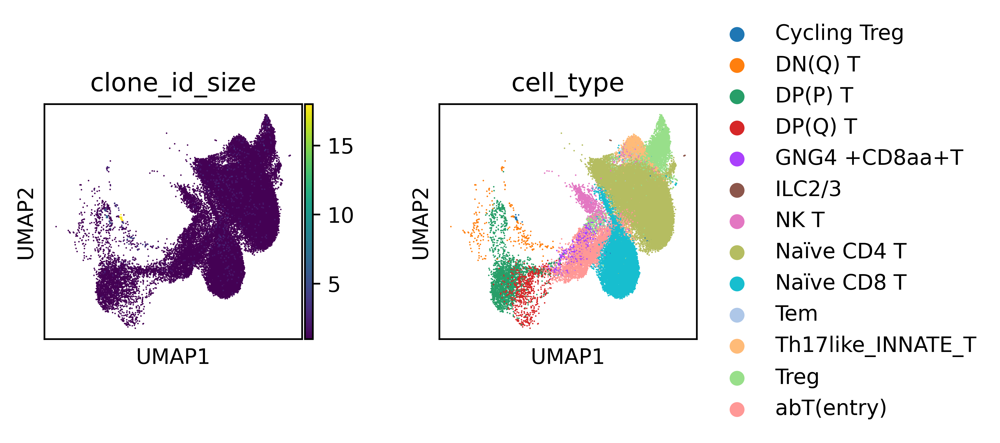

In [98]:
sc.pl.umap(adata, color=["clone_id_size", "cell_type"])

<Axes: title={'center': 'Number of cells in clone_id by cell_type'}, xlabel='clone_id', ylabel='Number of cells'>

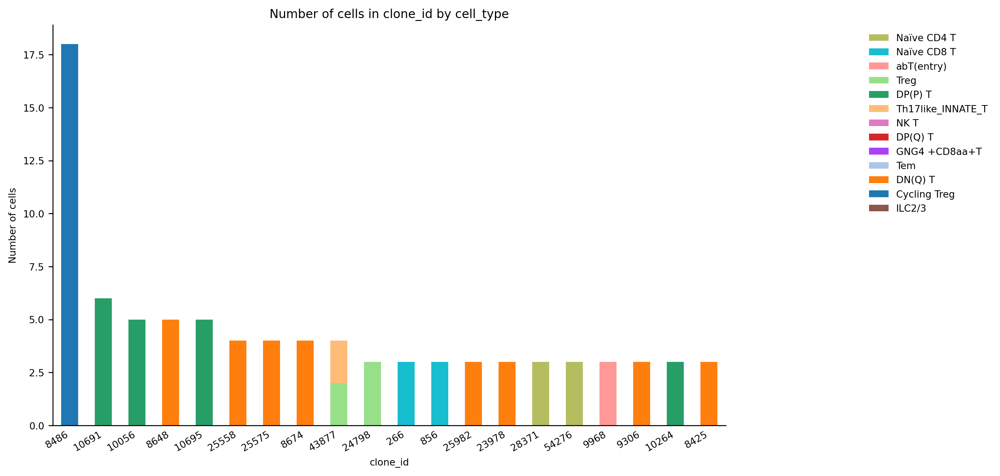

In [99]:
ir.pl.group_abundance(adata, groupby="clone_id", target_col="cell_type", max_cols=20,figsize=[10, 6])

<Axes: title={'center': 'Number of cells in clone_id by AdjustedID'}, xlabel='clone_id', ylabel='Number of cells'>

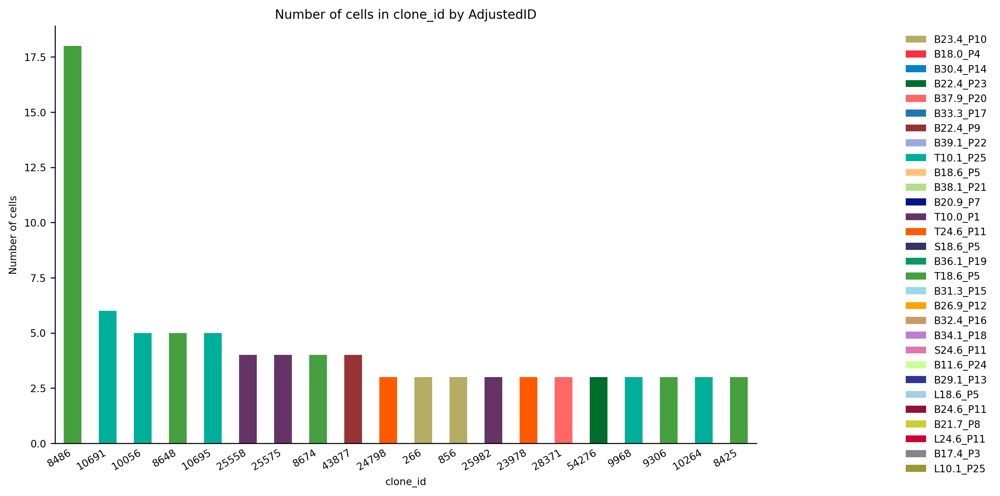

In [100]:
ir.pl.group_abundance(adata, groupby="clone_id", target_col="AdjustedID", max_cols=20,figsize=[10, 6])

In [101]:
help(ir.tl.spectratype)

Help on function spectratype in module scirpy.tl._spectratype:

spectratype(adata: anndata._core.anndata.AnnData, groupby: Union[str, Collection[str]] = 'IR_VJ_1_junction_aa', *, target_col: str, combine_fun: Callable = <function sum at 0x7f36f823e5e0>, fraction: Union[NoneType, str, bool] = None) -> pandas.core.frame.DataFrame
    Summarizes the distribution of :term:`CDR3` region lengths.
    
    Ignores NaN values.
    
    Parameters
    ----------
    adata
        AnnData object to work on.
    groupby
        Column(s) containing CDR3 sequences.
    target_col
        Color by this column from `obs`. E.g. sample or diagnosis
    combine_fun
        A function definining how the groupby columns should be merged
        (e.g. sum, mean, median, etc).
    fraction
        If True, compute fractions of abundances relative to the `groupby` column
        rather than reporting abosolute numbers. Alternatively, a column
        name can be provided according to that the values will be

In [102]:
help(ir.tl.spectratype)

Help on function spectratype in module scirpy.tl._spectratype:

spectratype(adata: anndata._core.anndata.AnnData, groupby: Union[str, Collection[str]] = 'IR_VJ_1_junction_aa', *, target_col: str, combine_fun: Callable = <function sum at 0x7f36f823e5e0>, fraction: Union[NoneType, str, bool] = None) -> pandas.core.frame.DataFrame
    Summarizes the distribution of :term:`CDR3` region lengths.
    
    Ignores NaN values.
    
    Parameters
    ----------
    adata
        AnnData object to work on.
    groupby
        Column(s) containing CDR3 sequences.
    target_col
        Color by this column from `obs`. E.g. sample or diagnosis
    combine_fun
        A function definining how the groupby columns should be merged
        (e.g. sum, mean, median, etc).
    fraction
        If True, compute fractions of abundances relative to the `groupby` column
        rather than reporting abosolute numbers. Alternatively, a column
        name can be provided according to that the values will be

In [103]:
adata.obs['cell_type'].value_counts()

Naïve CD4 T          30940
Naïve CD8 T          12758
abT(entry)            3945
Treg                  3616
DP(P) T               2298
Th17like_INNATE_T     1683
NK T                  1179
DP(Q) T                669
GNG4 +CD8aa+T          547
Tem                    373
DN(Q) T                248
Cycling Treg            38
ILC2/3                   7
Name: cell_type, dtype: int64

In [104]:
adata_noT12P25=adata[~adata.obs['AdjustedID'].isin(['T12.P25'])]
adata_noT12P25

View of AnnData object with n_obs × n_vars = 58301 × 31424
    obs: 'Name', 'doublet_scores', 'predicted_doublets', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Cellname', 'AdjustedID', 'New_Body', 'Week', 'TCRBCRlabel', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Last_cell_type', 'Cell_lineage', 'Last_cell_type2', 'Last_cell_type_num', 'Last_cell_type_num2', 'is_cell', 'high_confidence', 'multi_chain', 'extra_chains', 'IR_VJ_1_c_call', 'IR_VJ_2_c_call', 'IR_VDJ_1_c_call', 'IR_VDJ_2_c_call', 'IR_VJ_1_consensus_count', 'IR_VJ_2_consensus_count', 'IR_VDJ_1_consensus_count', 'IR_VDJ_2_consensus_count', 'IR_VJ_1_d_call', 'IR_VJ_2_d_call', 'IR_VDJ_1_d_call', 'IR_VDJ_2_d_call', 'IR_VJ_1_duplicate_count', 'IR_VJ_2_duplicate_count', 'IR_VDJ_1_duplicate_count', 'IR_VDJ_2_duplicate_count', 'IR_VJ_1_j_call', 'IR_VJ_2_j_call', 'IR_VDJ_1_j_call', 'IR_VDJ_2_j_call', 'IR_VJ_1_junction', 'IR_VJ_2_junction', 'IR_VDJ_1_juncti

In [105]:
# adata.raw.to_adata()

In [106]:
adata_noT12P25.obs.AdjustedID

Cellname
Z48_AAAGCAACATGACGGA-1      B17.4_P3
Z48_AACCGCGGTTGGTGGA-1      B17.4_P3
Z48_AACCGCGTCCAAACTG-1      B17.4_P3
Z48_AACTCAGAGGTGCAAC-1      B17.4_P3
Z48_AACTTTCAGACATAAC-1      B17.4_P3
                             ...    
Z123_TTTGTCACACTGTTAG-1    B22.4_P23
Z123_TTTGTCACATTTGCTT-1    B22.4_P23
Z123_TTTGTCAGTAAGTGTA-1    B22.4_P23
Z123_TTTGTCAGTACCGTAT-1    B22.4_P23
Z123_TTTGTCATCTACTTAC-1    B22.4_P23
Name: AdjustedID, Length: 58301, dtype: category
Categories (30, object): ['B11.6_P24' < 'B17.4_P3' < 'B18.0_P4' < 'B18.6_P5' ... 'T18.6_P5' < 'T24.6_P11' < 'S18.6_P5' < 'S24.6_P11']

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scirpy/pl/base.py:262: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(order)


<Axes: title={'center': 'Spectratype of IR_VJ_1_junction_aa by AdjustedID'}, xlabel='IR_VJ_1_junction_aa length'>

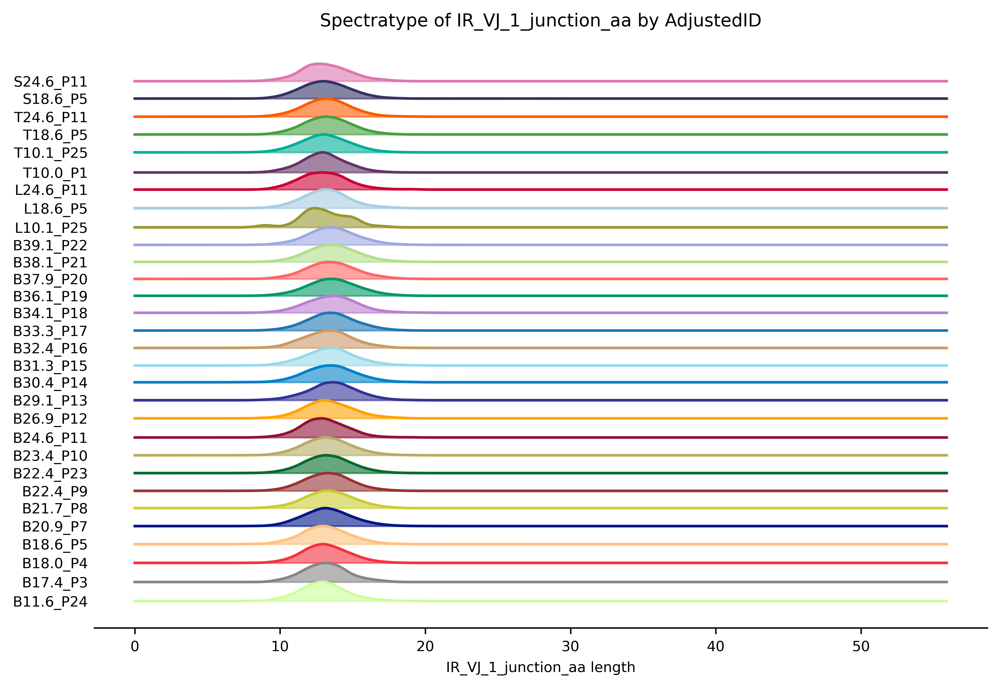

In [107]:
ir.pl.spectratype(
    adata,
    color="AdjustedID",
    viztype="curve",
    curve_layout="shifted",
    fig_kws={"dpi": 300,"figsize": (9, 6)},
    kde_kws={"kde_norm": True},figsize=[10, 10]
)

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scirpy/pl/base.py:262: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(order)


<Axes: title={'center': 'Spectratype of IR_VJ_1_junction_aa by AdjustedID'}, xlabel='IR_VJ_1_junction_aa length'>

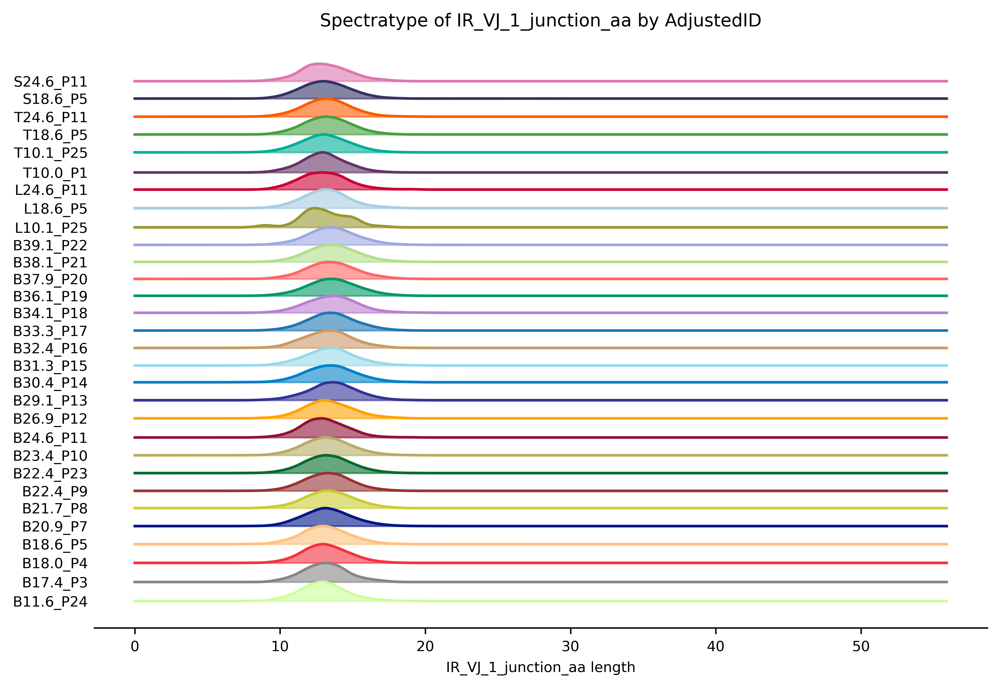

In [108]:
ir.pl.spectratype(
    adata,
    color="AdjustedID",
    viztype="curve",
    curve_layout="shifted",
    fig_kws={"dpi": 300,"figsize": (9, 6)},
    kde_kws={"kde_norm": False},
)

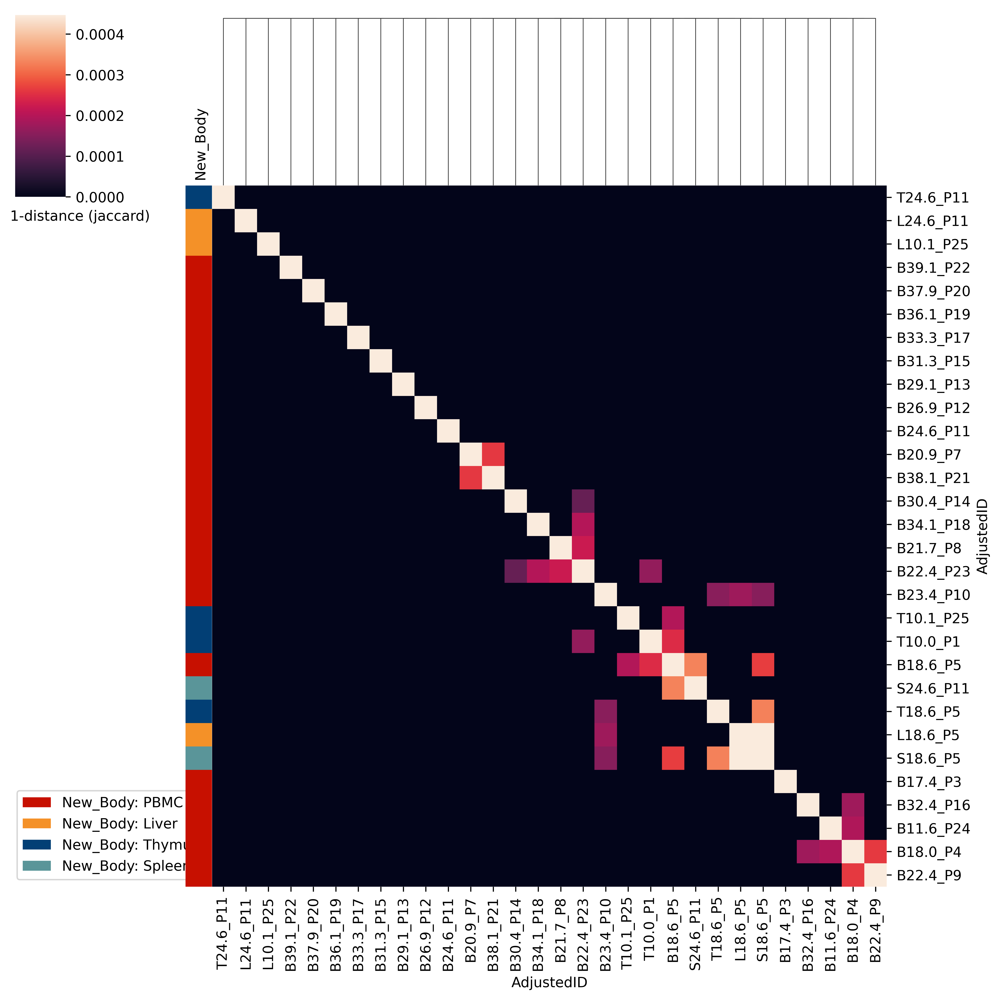

In [109]:
ir.pl.repertoire_overlap(adata, "AdjustedID", heatmap_cats=["New_Body"])

In [110]:
ir.tl.clonotype_modularity(adata, target_col="cc_aa_alignment")

Initalizing clonotype subgraphs...


  0%|          | 0/41471 [00:00<?, ?it/s]

Computing background distributions...


  0%|          | 0/1000 [00:00<?, ?it/s]

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0


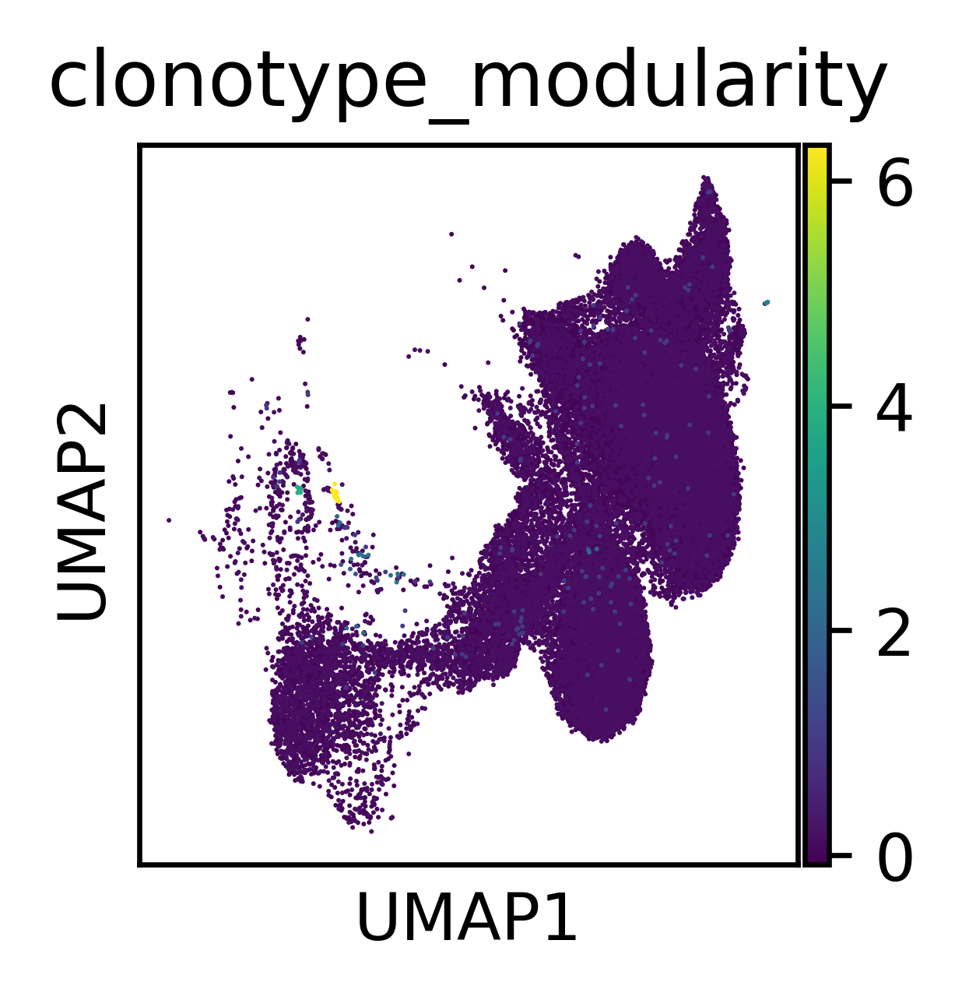

In [111]:
sc.pl.umap(adata, color="clonotype_modularity")

<Axes: title={'center': 'Spectratype of IR_VJ_1_junction_aa by AdjustedID'}, xlabel='IR_VJ_1_junction_aa length', ylabel='Number of cells'>

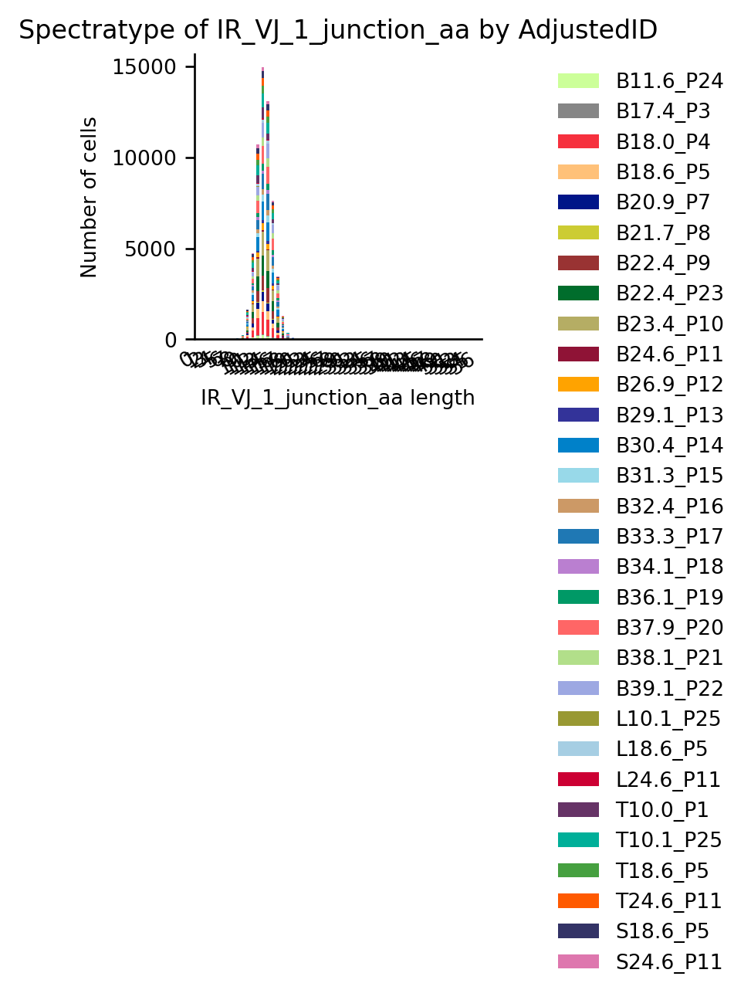

In [112]:
ir.pl.spectratype(adata, color="AdjustedID", viztype="bar", fig_kws={"dpi": 120})

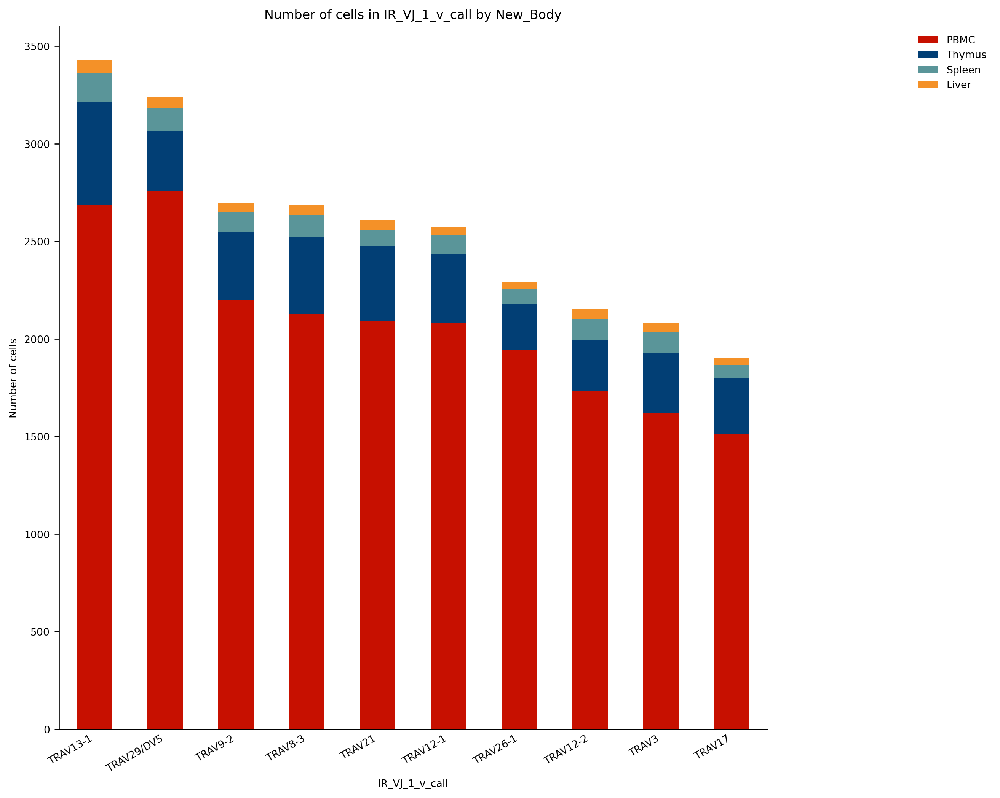

In [113]:
_ = ir.pl.group_abundance(
    adata,
    groupby="IR_VJ_1_v_call",
    target_col="New_Body",
    normalize=False,
    max_cols=10,
    figsize=[10, 10],
)

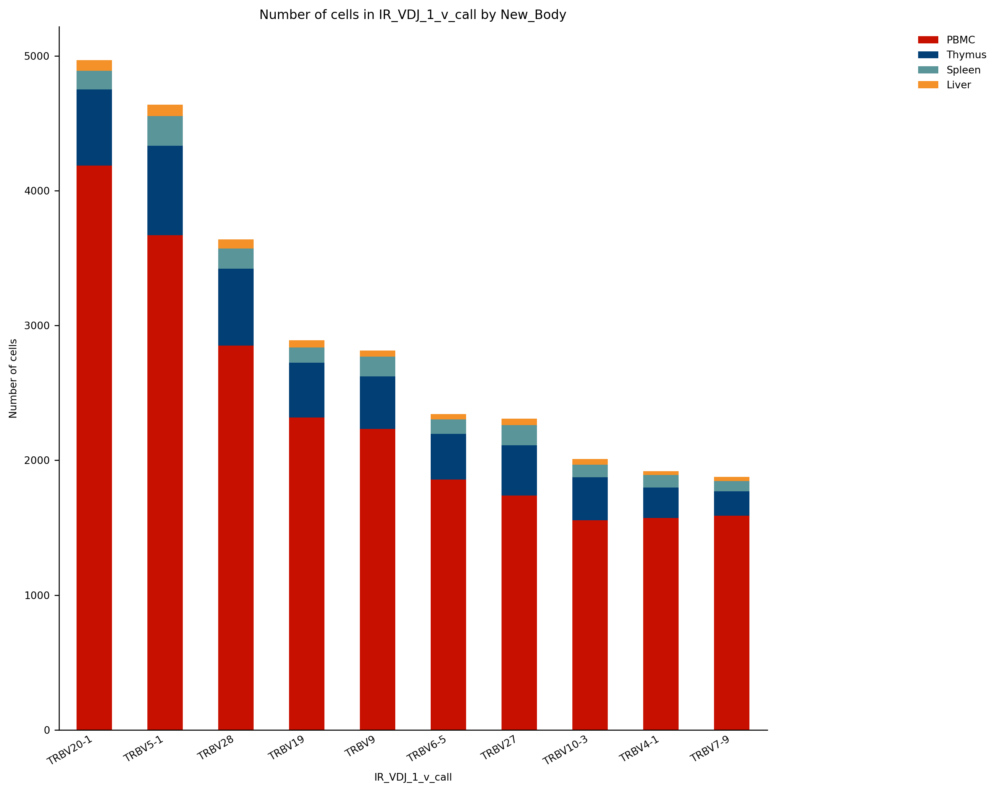

In [114]:
_ = ir.pl.group_abundance(
    adata,
    groupby="IR_VDJ_1_v_call",
    target_col="New_Body",
    normalize=False,
    max_cols=10,
    figsize=[10, 10],
)

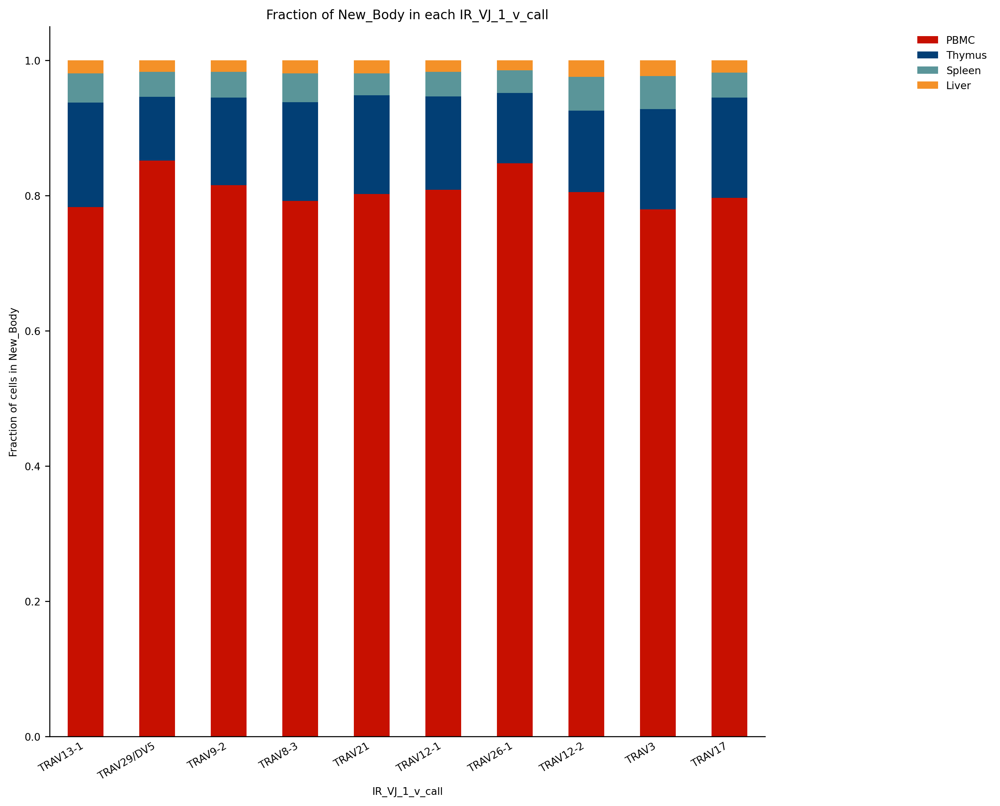

In [115]:
_ = ir.pl.group_abundance(
    adata,
    groupby="IR_VJ_1_v_call",
    target_col="New_Body",
    normalize=True,
    max_cols=10,
    figsize=[10, 10],
)

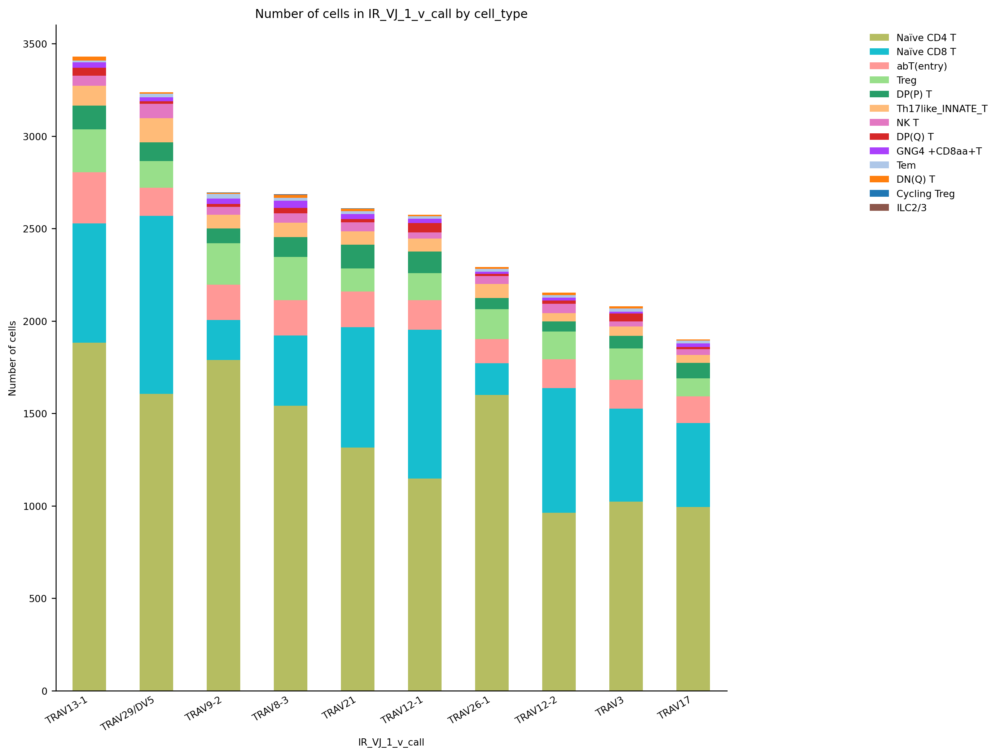

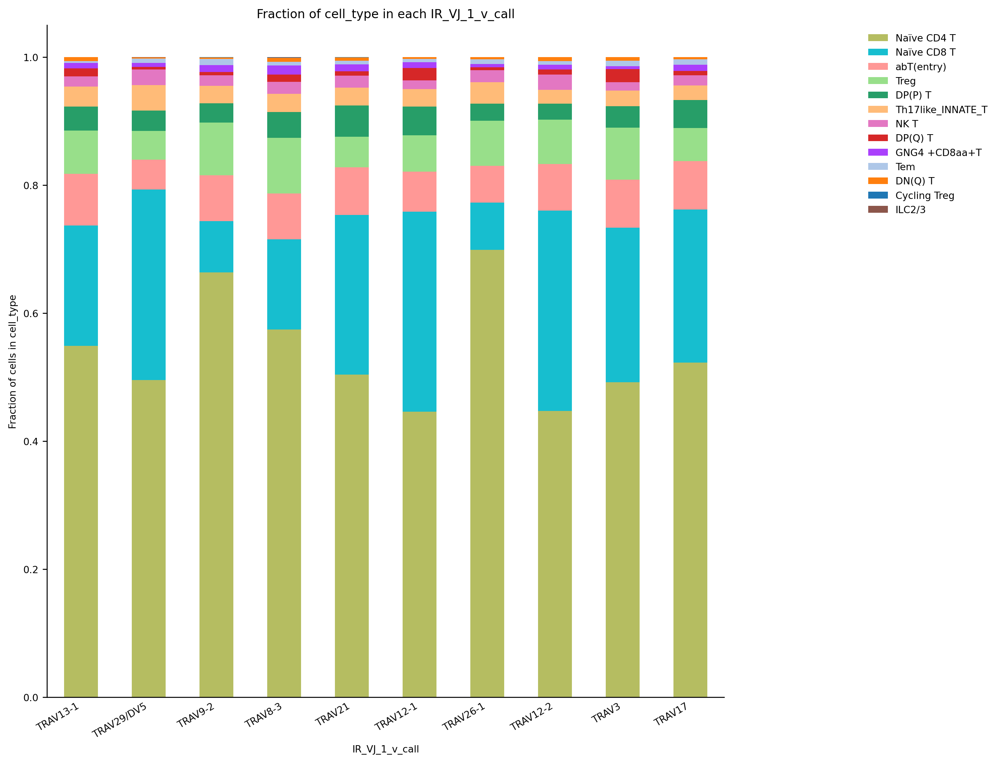

In [116]:
_ = ir.pl.group_abundance(
    adata,
    groupby="IR_VJ_1_v_call",
    target_col="cell_type",
    normalize=False,
    max_cols=10,
    figsize=[10, 10],
)

# Normalized abundances

_ = ir.pl.group_abundance(
    adata,
    groupby="IR_VJ_1_v_call",
    target_col="cell_type",
    normalize=True,
    max_cols=10,
    figsize=[10, 10],
)

In [117]:
adata.obs['cell_type'].unique()

['Treg', 'Th17like_INNATE_T', 'Naïve CD4 T', 'Naïve CD8 T', 'NK T', ..., 'GNG4 +CD8aa+T', 'DN(Q) T', 'DP(Q) T', 'Cycling Treg', 'DP(P) T']
Length: 13
Categories (13, object): ['Cycling Treg', 'DN(Q) T', 'DP(P) T', 'DP(Q) T', ..., 'Tem', 'Th17like_INNATE_T', 'Treg', 'abT(entry)']

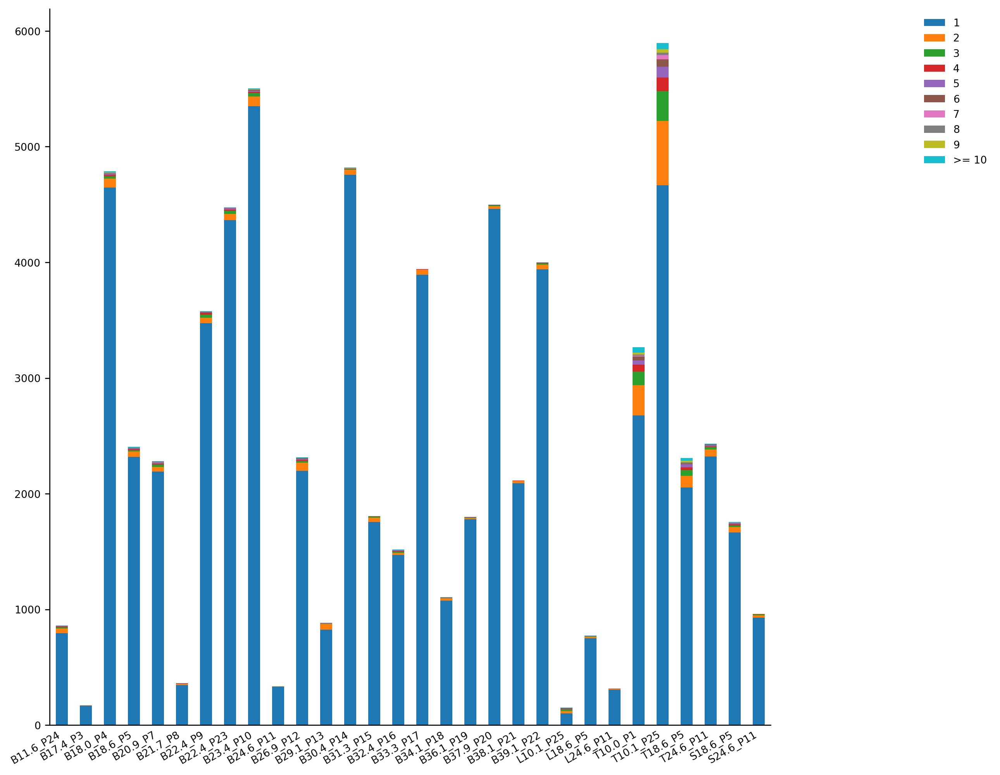

In [118]:
ir.tl.clonal_expansion(adata1_IR, target_col="cc_aa_identity")

_ = ir.pl.clonal_expansion(
    adata_tcr2,
    groupby="AdjustedID",
    target_col="cc_aa_identity",
    clip_at=10,
    normalize=False,
    figsize=[10, 10],
)

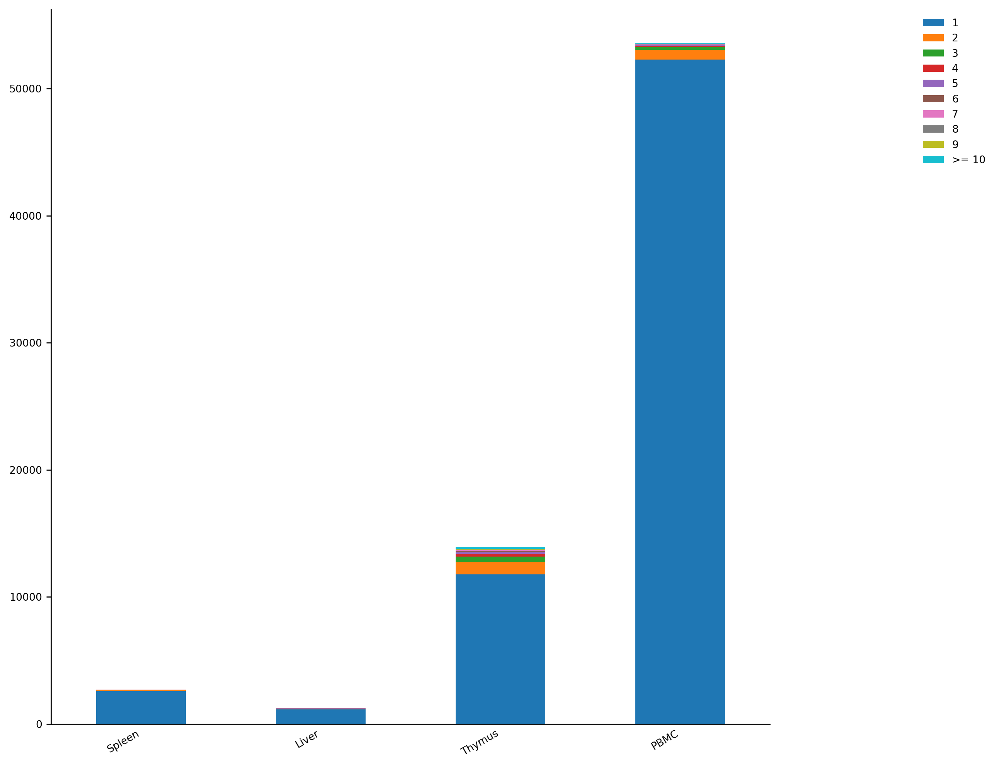

In [119]:
ir.tl.clonal_expansion(adata1_IR, target_col="cc_aa_identity")

_ = ir.pl.clonal_expansion(
    adata1_IR,
    groupby="New_Body",
    target_col="cc_aa_identity",
    clip_at=10,
    normalize=False,
    figsize=[10, 10]
)

In [120]:
adata_select=adata
# check all genes from adata are inside
TRAV_list = list(adata_select.obs['IR_VJ_1_v_call'].cat.categories)
TRAJ_list = list(adata_select.obs['IR_VJ_1_j_call'].cat.categories)
#TRGC_list = list(adata_select.obs['gd_IR_VJ_1_c_gene'].cat.categories[:-1])
TRBV_list = list(adata_select.obs['IR_VDJ_1_v_call'].cat.categories)
TRBD_list = list(adata_select.obs['IR_VDJ_1_d_call'].cat.categories[:-1])
TRBJ_list = list(adata_select.obs['IR_VDJ_1_j_call'].cat.categories[1:])
TCR_list = TRAV_list+TRAJ_list+TRBV_list+TRBD_list +TRBJ_list

In [121]:
# adata.write_h5ad("/home/maolp/Allcount/All_scanpyData/Data/Scanpy_lastCell_TCR.h5ad")

In [122]:
adata.obs.chain_pairing.unique()

['extra VDJ', 'single pair', 'extra VJ', 'two full chains']
Categories (4, object): ['extra VDJ', 'extra VJ', 'single pair', 'two full chains']

In [123]:
adata.obs.to_csv("/home/maolp/Allcount/All_scanpyData/Data/TCRobs.csv")